## Step1：total单细胞的分析、鉴定及注释，以及T细胞的分选

In [1]:
### 载入需要的包
scRNA_lib = c('Seurat', 'dplyr', 'clustree', 'ggplot2', 
               'ggsignif', 'tidyr', 'readr', 
              'data.table', 'pheatmap')
for (i in scRNA_lib){
  library(i, character.only = TRUE)
}

Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: ggraph

Loading required package: ggplot2


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last




In [2]:
mtxpath.vac.2 <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/02.count_v2/L1HHI2600059_Vac/outs/filtered_feature_bc_matrix/"
mtxpath.vac.1 <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/02.count/L1HHH0100338_Vac/outs/filtered_feature_bc_matrix/"
mtxpath.ctrl.2 <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/02.count_v2/L1HHI2600058_Control/outs/filtered_feature_bc_matrix/"
mtxpath.ctrl.1 <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/02.count/L1HHH0100337_Control/outs/filtered_feature_bc_matrix/"

In [3]:
###数据预处理
#数据导入，构建Seurat对象
#第二批样本
con_count <- Read10X(mtxpath.ctrl.2)
vac_count <- Read10X(mtxpath.vac.2)
con_data <- CreateSeuratObject(counts = con_count, project = 'con', min.cells = 3, min.features = 200)
vac_data <- CreateSeuratObject(counts = vac_count, project = 'vac', min.cells = 3, min.features = 200)
con_data$treat <- 'con.2'
vac_data$treat <- 'vac.2'

In [4]:
#第一批样本
con_count_1 <- Read10X(mtxpath.ctrl.1)
vac_count_1 <- Read10X(mtxpath.vac.1)
con_data_1 <- CreateSeuratObject(counts = con_count_1, project = 'con', min.cells = 3, min.features = 200)
vac_data_1 <- CreateSeuratObject(counts = vac_count_1, project = 'vac', min.cells = 3, min.features = 200)
con_data_1$treat <- 'con.1'
vac_data_1$treat <- 'vac.1'

In [5]:
#合并两样本
mydata <- merge(con_data, y=c(vac_data_1, con_data_1, vac_data))

Warning message in CheckDuplicateCellNames(object.list = objects):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [6]:
#str(mydata)

In [7]:
outpath <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/05.count_vdj"

In [8]:
#计算线粒体比例并查看分布，查看细胞批次现象，无明显批次现象
mydata[["percent.mt"]] <- PercentageFeatureSet(mydata, pattern = "^mt-")
vp <- VlnPlot(mydata, features = c("nFeature_RNA", "nCount_RNA","percent.mt"), ncol = 3)
FP1 <- FeatureScatter(mydata, feature1 = "nCount_RNA", feature2 = "percent.mt")
FP2 <- FeatureScatter(mydata, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
ggsave(paste0(outpath,"/VPlot.pdf"), plot = vp, width = 8, height = 6)
ggsave(paste0(outpath,"/FeatureScatter.pdf"), plot =FP1+FP2 , width = 8, height = 6)

In [9]:
#剔除低质量细胞
sce <- mydata
mydata <- subset(mydata, subset = nFeature_RNA > 100)
dim(mydata@meta.data)

[1] 18854     5

In [10]:
#str(sce)

[1] TRUE

Centering and scaling data matrix

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 0 features requested have not been scaled (running reduction without them): ”
PC_ 1 
Positive:  Srgn, Alox5ap, Ctss, Lyz2, Lilrb4b, Ucp2, Cxcl2, Cd14, Ctsc, Cd68 
	   Rac2, Bcl2a1b, Fth1, Fcgr2b, Ccr1, Cybb, Mpeg1, Adam8, Glrx, Ccl6 
	   Cfp, C5ar1, Il1b, Wfdc17, Gda, Cd300lf, Cd300c2, Csf1r, Ms4a6d, Ms4a6c 
Negative:  Cald1, Serpinh1, Bgn, Cavin3, Tm4sf1, Sparc, Crip2, Plac9, Htra1, Fbln2 
	   Cd34, Pcolce, Col6a3, Igfbp4, Fstl1, Tpm1, Nedd4, Phgdh, Oaf, Flnb 
	   Col6a1, Ltbp4, Mmp2, Sox9, Map1b, Tubb3, Cdh13, Cavin1, Tpm2, Dpysl3 
PC_ 2 
Positive:  Col3a1, Dcn, Col5a1, Prelp, Mxra8, Mmp2, Ramp2, Apod, Col6a2, Dclk1 
	   Col6a1, Gsn, Igfbp6, Fbn1, Sdc2, Pdgfrb, Adamts1, Islr, S100a9, Ly6c1 
	   S100a8, Fstl1, Lcn2, Medag, Cd248, Col5a2, Lbp, Retnlg, Sparc, Wfdc21 
Negative:  Top2a, Birc5, Pclaf, Mki67, Ccna2, Cdca8, H2az1, Smc2, Stmn1, Cdk1 
	   Ube2c,

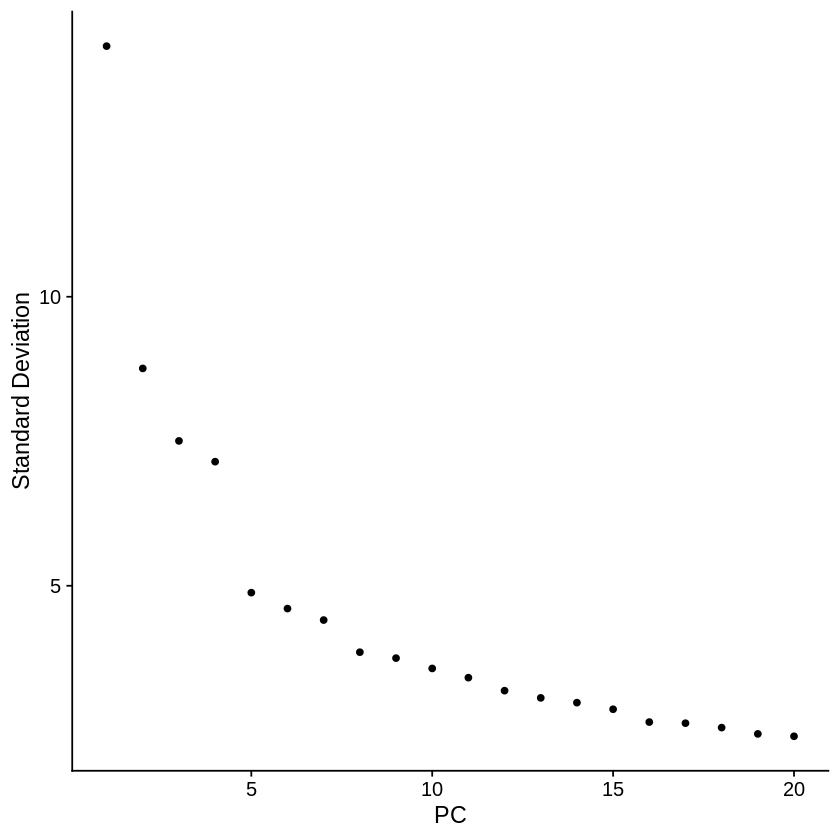

In [11]:
#标准化
sce <- NormalizeData(sce, normalization.method = "LogNormalize")

#鉴定高变基因
sce <- FindVariableFeatures(sce, selection.method = "vst", nfeatures = 2000)

must_contain_gene <- ("Lag3")
for (geneid in must_contain_gene) {
    VariableFeatures(sce) <- c(VariableFeatures(sce), geneid)
  }

#数据缩放
"Lag3" %in% VariableFeatures(sce)
sce = ScaleData(object = sce)

#PCA降维
sce = RunPCA(object = sce, do.print = FALSE)
ElbowPlot(sce)

In [12]:
# Check if "Lag3" is in the raw or normalized data
if ("Lag3" %in% rownames(sce@assays$RNA@data)) {
    print("Lag3 is in the raw data")
} else {
    print("Lag3 is not in the raw data")
}

if ("Lag3" %in% rownames(sce@assays$RNA@counts)) {
    print("Lag3 is in the normalized data")
} else {
    print("Lag3 is not in the normalized data")
}

if ("Lag3" %in% rownames(sce@assays$RNA@scale.data)) {
    print("Lag3 is in the scale.data")
} else {
    print("Lag3 is not in the scale.data")
}


[1] "Lag3 is in the raw data"
[1] "Lag3 is in the normalized data"
[1] "Lag3 is in the scale.data"


In [13]:
#细胞聚类
dimnum <- 15
#res <-0.1
sce <- FindNeighbors(sce, dims = 1:15)
sce <- FindClusters(sce, resolution = c(0.08, 0.1, 0.5)) 

#UMAP
sce <- RunUMAP(sce, dims = 1:dimnum)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 18854
Number of edges: 594021

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9695
Number of communities: 6
Elapsed time: 3 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 18854
Number of edges: 594021

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9638
Number of communities: 8
Elapsed time: 3 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 18854
Number of edges: 594021

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9148
Number of communities: 20
Elapsed time: 3 seconds


Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
07:04:18 UMAP embedding parameters a = 0.9922 b = 1.112

07:04:18 Read 18854 rows and found 15 numeric columns

07:04:18 Using Annoy for neighbor search, n_neighbors = 30

07:04:18 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

07:04:20 Writing NN index file to temp file /tmp/Rtmpgdjkzu/file3b807fd4e771

07:04:20 Searching Annoy index using 1 thread, search_k = 3000

07:04:26 Annoy recall = 100%

07:04:26 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors 

In [14]:
#str(sce)

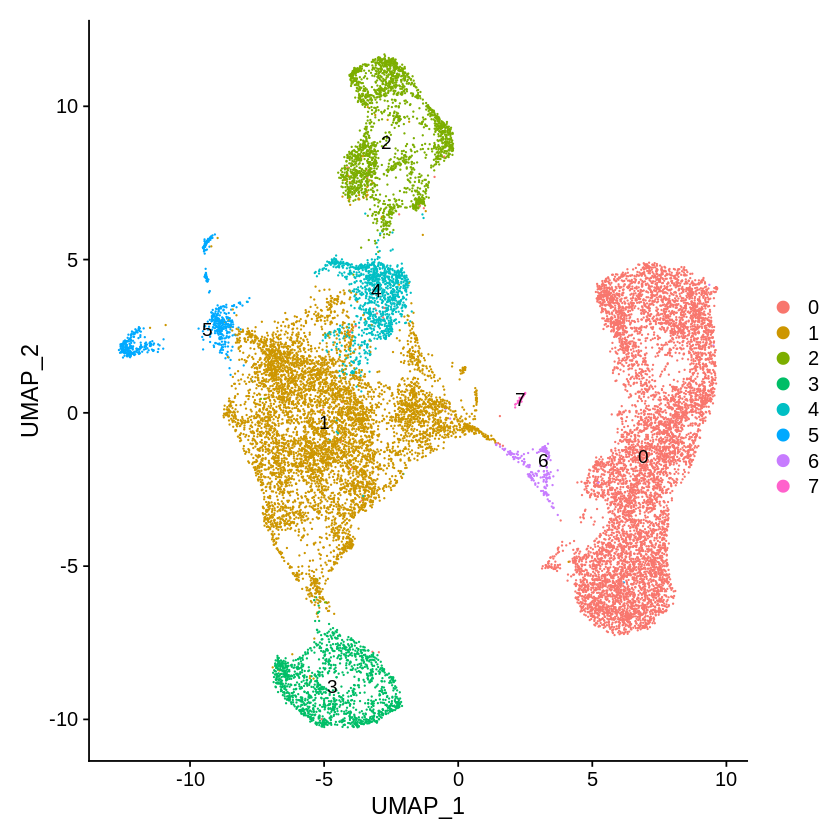

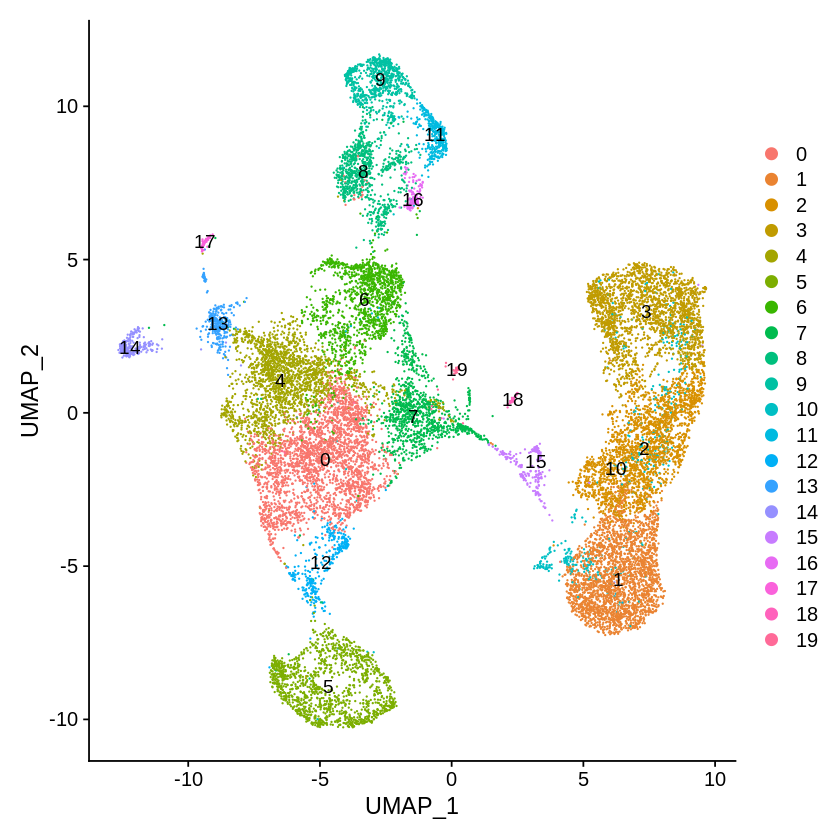

In [15]:
Idents(sce) <- 'RNA_snn_res.0.1'
DimPlot(sce, reduction = "umap",label = TRUE, pt.size = 0.01)
Idents(sce) <- 'RNA_snn_res.0.5'
DimPlot(sce, reduction = "umap",label = TRUE, pt.size = 0.01)

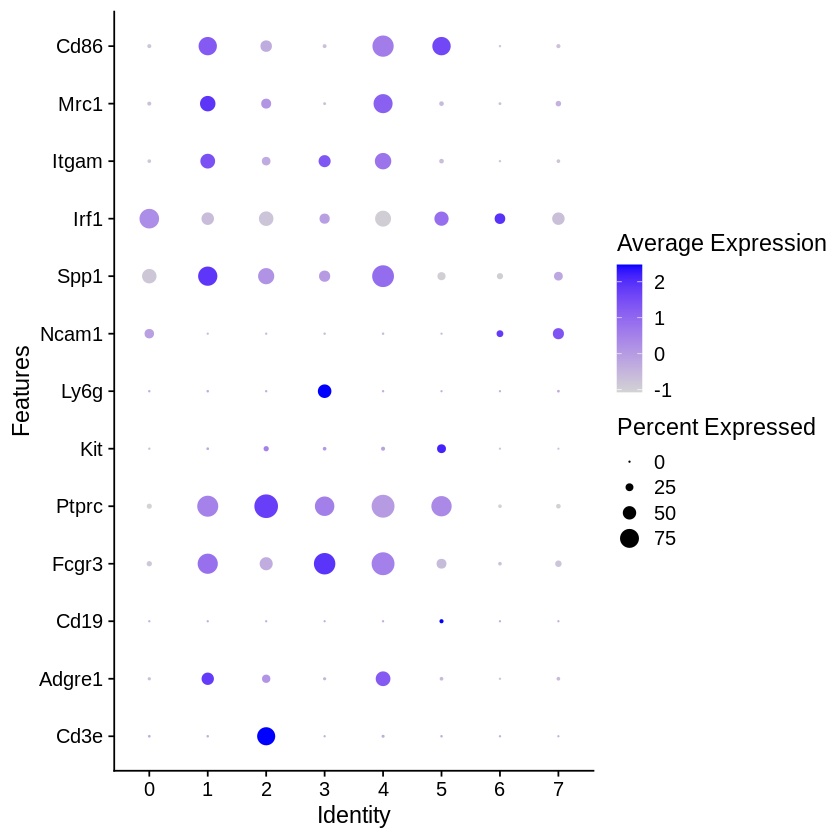

In [16]:
#删除非免疫细胞
Idents(sce) <- 'RNA_snn_res.0.1'
DotPlot(sce, features = c('Cd3e', 'Adgre1', 'Cd19', 'Fcgr3', 'Ptprc', 'Kit', 'Ly6g', 'Ncam1','Spp1','Irf1','Itgam','Mrc1','Cd86'),assay = 'RNA')+coord_flip()
sce1 <- subset(sce, idents = c('1', '2', '3', '4', '5', '6', '7'))

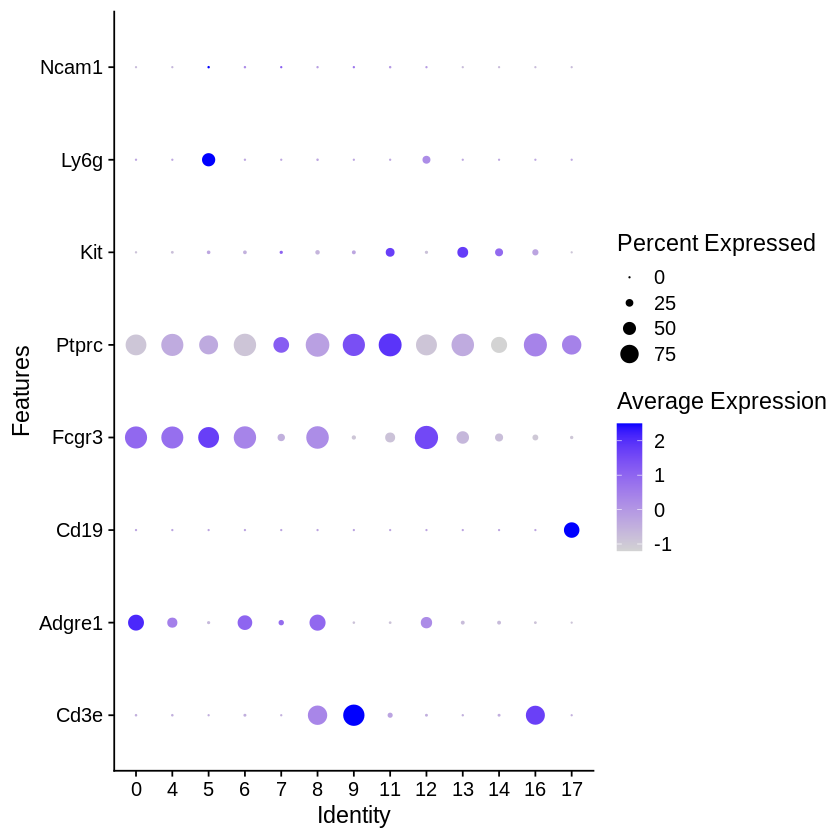

In [17]:
#删除无CD45表达的低质量群
Idents(sce) <- 'RNA_snn_res.0.5'
sce2 <- subset(sce, idents = c('0','4' ,'5', '6', '7', '8', '9', 
                               '11', '12', '13', '14', '16', '17'))
DotPlot(sce2, features = c('Cd3e', 'Adgre1', 'Cd19', 'Fcgr3', 'Ptprc', 'Kit', 'Ly6g', 'Ncam1'),assay = 'RNA')+coord_flip()

new.cluster.ids <- c("0"="Myeloid",  
                     "4"="Myeloid", 
                     "5"="Myeloid-Neu", 
                     '6'='Myeloid', 
                     '7'='Myeloid', 
                     '8'='T cell', 
                     '9'='T cell', 
                     #'10' = 'Myeloid', 
                     '11'='NK', 
                     '12'='Myeloid', 
                     '13'='Myeloid', 
                     '14'='Myeloid', 
                     '16'='T cell', 
                     '17'='B cell')
sce2 <- RenameIdents(sce2, new.cluster.ids)   
#sce$celltype <- Idents(sce2)
pa <- DimPlot(sce2, label = T)
pb <- DimPlot(sce2, label = T,split.by="orig.ident")
ggsave(paste0(outpath,"/CD45.annoted.vac.con.pdf"), plot = pb, width = 16, height = 8)
ggsave(paste0(outpath,"/CD45.annoted.pdf"), plot = pa, width = 10, height = 8)

In [18]:
#str(sce2)

In [19]:
###提取T细胞单独分析
t_cell <- subset(sce2, idents = c('T cell'))

## Step2: T细胞亚群的分析、鉴定及注释

In [20]:
#str(t_cell)

In [21]:
#标准化
t_cell <- NormalizeData(t_cell, normalization.method = "LogNormalize")
#鉴定细胞间表达量高变的基因（feature selection）
t_cell <- FindVariableFeatures(t_cell, selection.method = "vst", nfeatures = 2000)


must_contain_gene <- ("Lag3")
for (geneid in must_contain_gene) {
    VariableFeatures(t_cell) <- c(VariableFeatures(t_cell), geneid)
  }

#数据缩放
"Lag3" %in% VariableFeatures(t_cell)

t_cell = ScaleData(object = t_cell)

[1] TRUE

Centering and scaling data matrix



In [22]:
#str(t_cell)
scaled_data <- GetAssayData(t_cell,slot="scale.data")
grep("La", rownames(scaled_data), value = TRUE)

[1] "Lad1"   "Lamp2"  "Lap3"   "Lag3"   "Lair1"  "Lamp1"  "Large1" "Lacc1"

PC_ 1 
Positive:  Pdcd1, Lag3, Rgs16, Ifng, Pglyrp1, Icos, Tnfrsf9, Ctla2a, Gem, Nrgn 
	   Ctla4, Bcl2, Cd5, Tox, Prf1, Phgdh, Gzmb, Csf1, Gramd3, Dut 
	   Slc2a3, Kcnq5, Smyd3, Satb1, St6galnac3, Styk1, Sdf4, Sntb1, Mctp2, Filip1 
Negative:  Alox5ap, Grn, Tyrobp, Fcgr2b, Ctss, Lyz2, Lgmn, Fcgr3, Psap, App 
	   Ctsz, Csf1r, Cd68, Ctsh, Tgfbi, Mpeg1, C1qb, Ifi30, Dab2, Cybb 
	   Spi1, Ctsc, Sirpa, C1qc, Ly86, C1qa, Cfp, Fcer1g, Pld4, Apoe 
PC_ 2 
Positive:  Pclaf, Top2a, Birc5, Stmn1, H1f5, H2ac8, Mki67, Ccna2, Cdk1, Tpx2 
	   Cks1b, Spc24, Rrm2, Cdca3, Cdca8, Nusap1, Ube2c, Kif11, Smc2, Knl1 
	   Prc1, Tubb5, Asf1b, Tuba1b, H2ac4, H3c3, H2ax, Hmgb2, Tk1, Cenpf 
Negative:  Slfn5, Slfn1, Gramd3, Ifi213, Irf7, Il7r, Ifit3, Slfn4, Ccl5, Lef1 
	   Ifi27l2a, Isg20, Ifih1, Mxd1, Ppp1r15a, Oasl2, St6galnac3, Sqstm1, Jun, Rtp4 
	   Oas1g, Ifi209, Slco3a1, Nfkbiz, Ecm1, Chil3, Sntb1, Oasl1, Lilrb4b, Marchf3 
PC_ 3 
Positive:  Slfn4, Irf7, Isg15, Lcn2, Hp, S100a8, Mmp8, Slfn1, S100a9, Ifi27l2a 
	

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1690
Number of edges: 64720

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7059
Number of communities: 14
Elapsed time: 0 seconds


07:04:57 UMAP embedding parameters a = 0.9922 b = 1.112

07:04:57 Read 1690 rows and found 10 numeric columns

07:04:57 Using Annoy for neighbor search, n_neighbors = 30

07:04:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

07:04:57 Writing NN index file to temp file /tmp/Rtmpgdjkzu/file3b80519ba157

07:04:57 Searching Annoy index using 1 thread, search_k = 3000

07:04:57 Annoy recall = 100%

07:04:58 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

07:04:59 Initializing from normalized Laplacian + noise (using irlba)

07:04:59 Commencing optimization for 500 epochs, with 67902 positive edges

07:05:02 Optimization finished



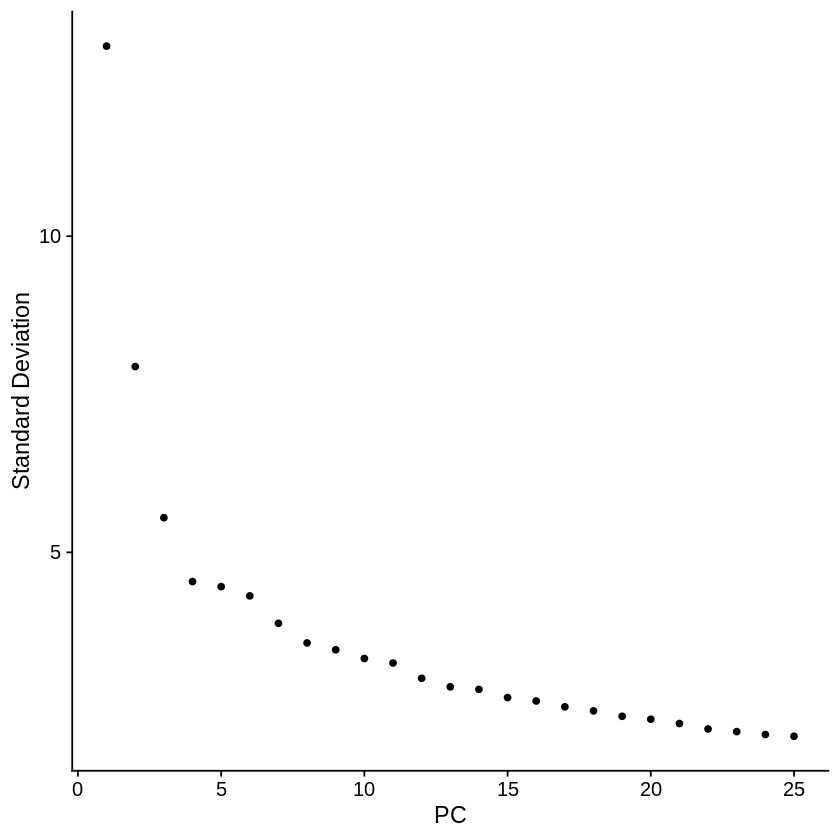

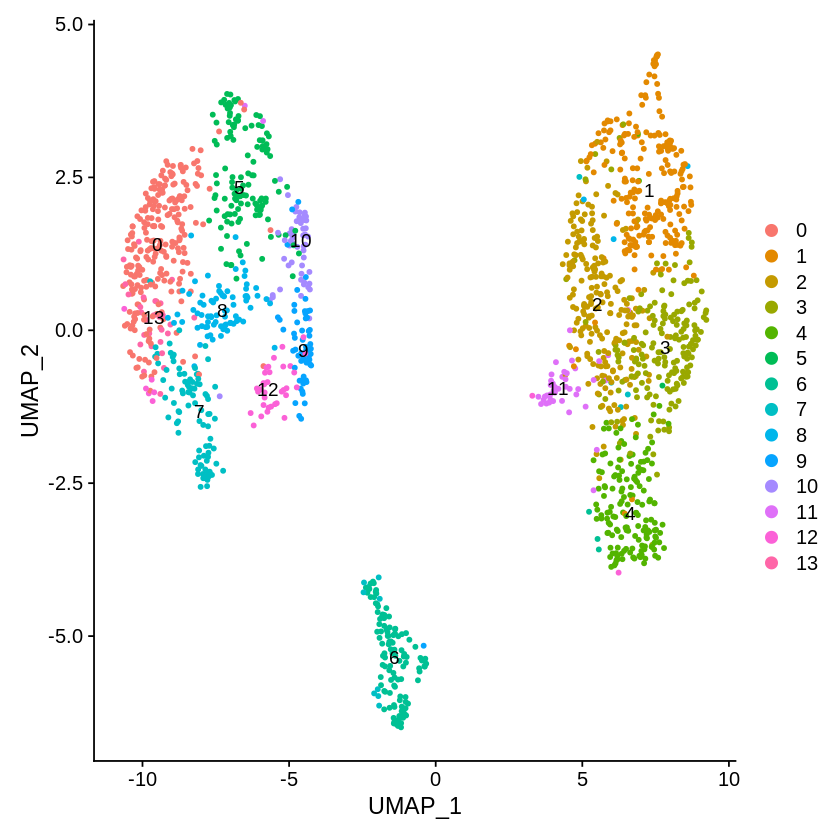

In [23]:
#PCA降维
t_cell = RunPCA(object = t_cell, do.print = FALSE)
#降维可视化
ElbowPlot(t_cell, ndims = 25)
#细胞聚类
t_cell <- FindNeighbors(t_cell, dims = 1:30)
t_cell <- FindClusters(t_cell, resolution = c(1.5)) 
t_cell <- RunUMAP(t_cell, dims = 1:10)
Idents(t_cell) <-  'celltype_'
Idents(t_cell) <-  'RNA_snn_res.1.5'
DimPlot(t_cell, pt.size = 1, label = T, reduction = 'umap')

In [24]:
#str(t_cell)

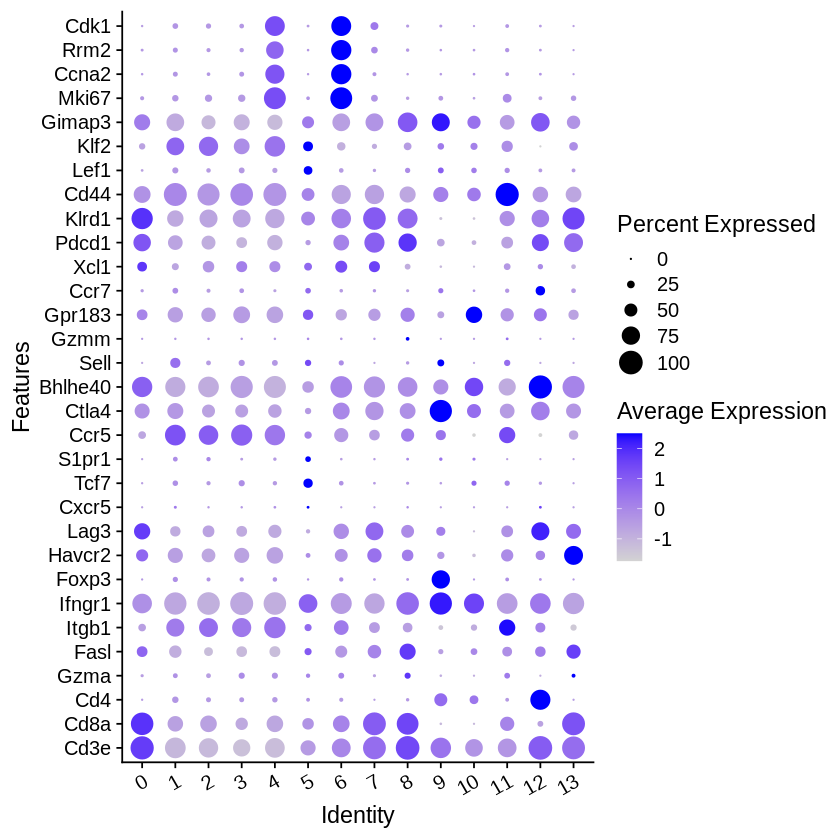

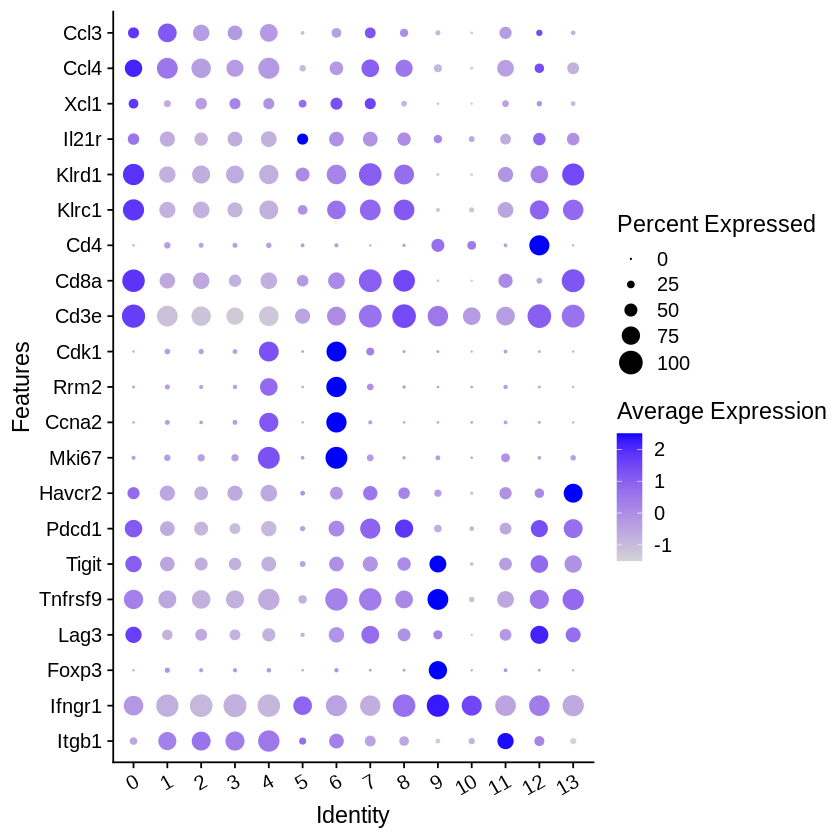

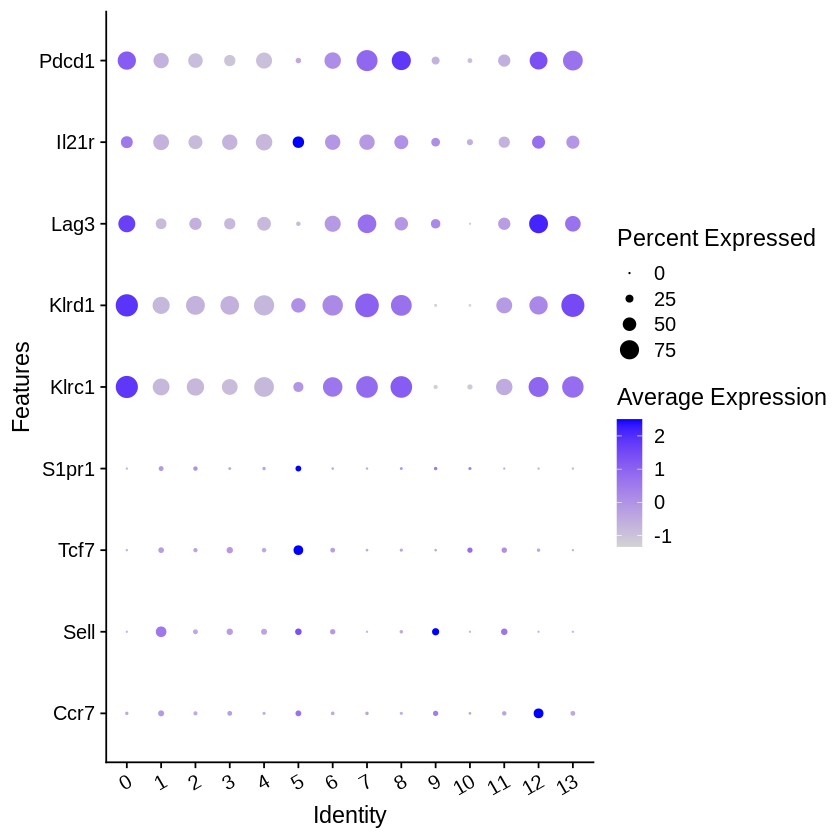

In [25]:
###分群鉴定
##1
DotPlot(t_cell, features = c('Cd3e','Cd8a','Cd4','Gzma', 'Fasl', 'Itgb1', 'Ifngr1', 'Foxp3', 'Havcr2', 
                             'Lag3', 'Cxcr5', 'Tcf7', 'S1pr1', 'Ccr5', 'Ctla4', 
                             'Bhlhe40', 'Sell', 'Gzmm', 'Gpr183', 'Ccr7', 'Xcl1', 'Pdcd1', 
                             'Klrd1', 'Cd44', 'Lef1', 'Klf2', 'Gimap3','Mki67', 'Ccna2', 'Rrm2','Cdk1'))+
  coord_flip()+
  theme(axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1))

##2衰竭/增殖
DotPlot(t_cell, features = c('Itgb1', 'Ifngr1', 'Foxp3', 
                             'Lag3', 'Tnfrsf9', 'Tigit', 'Pdcd1', 'Havcr2',
                             'Mki67', 'Ccna2', 'Rrm2','Cdk1', 
                             'Cd3e','Cd8a','Cd4', 'Klrc1','Klrd1', 'Il21r', 
                             'Xcl1', 'Ccl4', 'Ccl3'))+
  coord_flip()+
  theme(axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1))
##3
DotPlot(t_cell, features = c('Ccr7', 'Sell', 'Tcf7', 'S1pr1', 'Klrc1', 'Klrd1', 'Lag3', 'Il21r','Pdcd1'))+
  coord_flip()+
  theme(axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1))

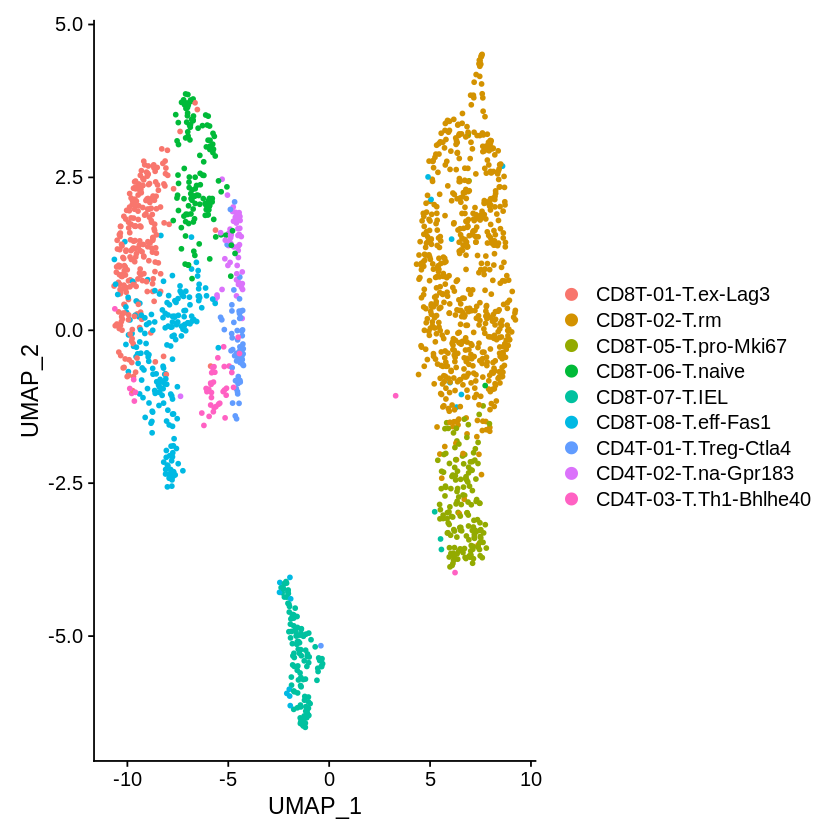

In [26]:
t_cell_1 <- subset(t_cell,idents = c('0','1','2','3','4','5','6','7','8','9','10','12','13'))
new.cluster.ids <- c("0"="CD8T-01-T.ex-Lag3", 
                     "1"="CD8T-02-T.rm", 
                     "2"="CD8T-02-T.rm", 
                     "3"="CD8T-02-T.rm", 
                     "4"="CD8T-05-T.pro-Mki67", 
                     "5"="CD8T-06-T.naive", 
                     "6"="CD8T-07-T.IEL", 
                     "7"="CD8T-08-T.eff-Fas1", 
                     "8"="CD8T-08-T.eff-Fas1",
                     "9"="CD4T-01-T.Treg-Ctla4", 
                     "10"="CD4T-02-T.na-Gpr183",
                     '12'='CD4T-03-T.Th1-Bhlhe40', 
                     '13'='CD8T-08-T.eff-Fas1')
t_cell_1 <- RenameIdents(t_cell_1, new.cluster.ids)   
t_cell_1$celltype_ <- t_cell_1@active.ident

p.annot <- DimPlot(t_cell_1)
ggsave(paste0(outpath,"/Tcells.annoted.pdf"), plot = p.annot, width = 10, height = 8)
p.annot

Warning message in FetchData.Seurat(object = object, vars = features, cells = cells):
“The following requested variables were not found: Cd137”


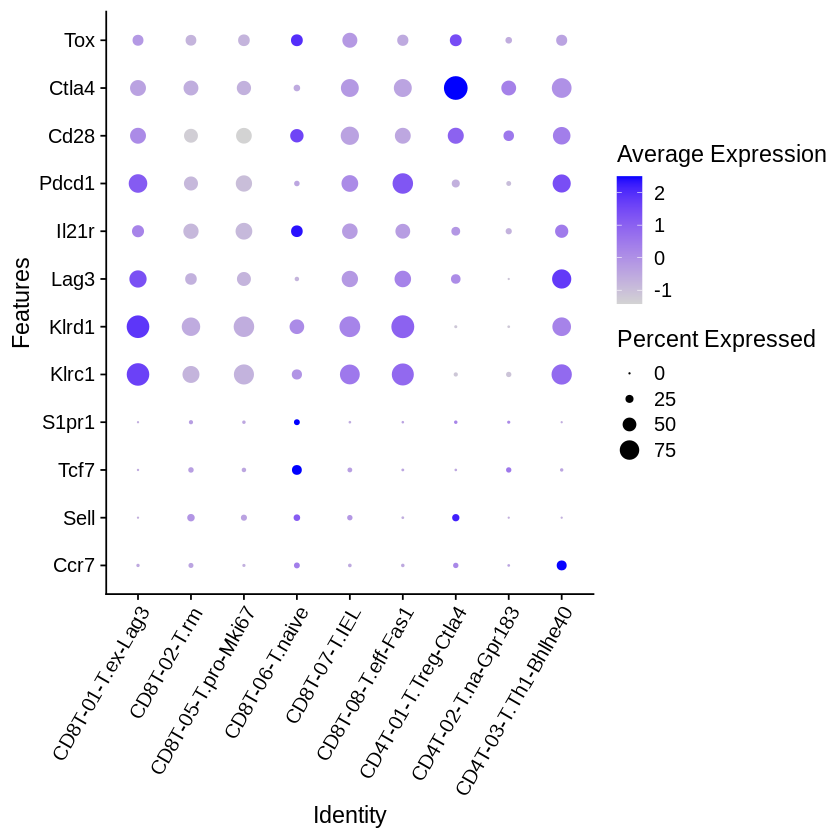

In [27]:
DotPlot(t_cell_1, features = c('Ccr7', 'Sell', 'Tcf7', 'S1pr1', 'Klrc1', 'Klrd1', 'Lag3', 'Il21r','Pdcd1',"Cd28",'Cd137',"Ctla4","Tox"))+
  coord_flip()+
  theme(axis.text.x = element_text(angle = 60, hjust = 1, vjust = 1))

In [28]:
dim(t_cell_1@meta.data)
write.csv(data.frame(table(t_cell_1@meta.data$celltype_)),paste0(outpath,"/T.cell.num.per.type.csv"))

[1] 1647   11

In [29]:
scaled_data_1 <- GetAssayData(t_cell_1,slot="scale.data")
grep("La", rownames(scaled_data_1), value = TRUE)


# Check if "Lag3" is in the raw or normalized data
if ("Lag3" %in% rownames(t_cell_1@assays$RNA@data)) {
    print("Lag3 is in the raw data")
} else {
    print("Lag3 is not in the raw data")
}

if ("Lag3" %in% rownames(t_cell_1@assays$RNA@counts)) {
    print("Lag3 is in the normalized data")
} else {
    print("Lag3 is not in the normalized data")
}

if ("Lag3" %in% rownames(t_cell_1@assays$RNA@scale.data)) {
    print("Lag3 is in the scale.data")
} else {
    print("Lag3 is not in the scale.data")
}

#scaled_data
exhaust_scaled_data <- scaled_data_1["Lag3",]
length(exhaust_scaled_data)
str(t_cell_1@meta.data)

[1] "Lad1"   "Lamp2"  "Lap3"   "Lag3"   "Lair1"  "Lamp1"  "Large1" "Lacc1"

[1] "Lag3 is in the raw data"
[1] "Lag3 is in the normalized data"
[1] "Lag3 is in the scale.data"


[1] 1647

'data.frame':	1647 obs. of  11 variables:
 $ orig.ident      : chr  "con" "con" "con" "con" ...
 $ nCount_RNA      : num  4252 5038 5839 27176 7498 ...
 $ nFeature_RNA    : int  1917 1870 1912 5341 2574 3528 1291 2282 4993 3108 ...
 $ treat           : chr  "con.2" "con.2" "con.2" "con.2" ...
 $ percent.mt      : num  0.0706 1.4688 0.6679 0.8316 0.4668 ...
 $ RNA_snn_res.0.08: Factor w/ 6 levels "0","1","2","3",..: 3 3 3 3 3 3 3 3 3 3 ...
 $ RNA_snn_res.0.1 : Factor w/ 8 levels "0","1","2","3",..: 3 3 3 3 3 3 3 3 3 3 ...
 $ RNA_snn_res.0.5 : Factor w/ 20 levels "0","1","2","3",..: 10 10 10 9 17 9 10 10 9 9 ...
 $ seurat_clusters : Factor w/ 14 levels "0","1","2","3",..: 1 1 14 3 7 4 6 8 4 3 ...
 $ RNA_snn_res.1.5 : Factor w/ 14 levels "0","1","2","3",..: 1 1 14 3 7 4 6 8 4 3 ...
 $ celltype_       : Factor w/ 9 levels "CD8T-01-T.ex-Lag3",..: 1 1 6 2 5 2 4 6 2 2 ...


## Step3：scRNA + scTCR 的整合分析

In [30]:
### 整合TCR数据
TCR.con.1.path <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/03.vdj/L1HHH0100337_Control_TCR/outs"
TCR.vac.1.path <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/03.vdj/L2HHH0100338_Vac_TCR/outs"
TCR.con.2.path <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/03.vdj_v2/L2HHI2600058_Control_TCR/outs"
TCR.vac.2.path <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/03.vdj_v2/L2HHI2600059_Vac_TCR/outs"

In [31]:
TCR.con.1.airr <- read.csv(paste0(TCR.con.1.path,"/airr_rearrangement.tsv"),sep="\t")
TCR.vac.1.airr <- read.csv(paste0(TCR.vac.1.path,"/airr_rearrangement.tsv"),sep="\t")
TCR.con.2.airr <- read.csv(paste0(TCR.con.2.path,"/airr_rearrangement.tsv"),sep="\t")
TCR.vac.2.airr <- read.csv(paste0(TCR.vac.2.path,"/airr_rearrangement.tsv"),sep="\t")

In [32]:
TCR.con.1.clonetype <- read.csv(paste0(TCR.con.1.path,"/clonotypes.csv"),sep=",")
TCR.vac.1.clonetype <- read.csv(paste0(TCR.vac.1.path,"/clonotypes.csv"),sep=",")
TCR.con.2.clonetype <- read.csv(paste0(TCR.con.2.path,"/clonotypes.csv"),sep=",")
TCR.vac.2.clonetype <- read.csv(paste0(TCR.vac.2.path,"/clonotypes.csv"),sep=",")

In [33]:
con.1 <- merge(TCR.con.1.airr,TCR.con.1.clonetype,by.x = "clone_id", by.y ="clonotype_id")
vac.1 <- merge(TCR.vac.1.airr,TCR.vac.1.clonetype,by.x = "clone_id", by.y ="clonotype_id")
con.2 <- merge(TCR.con.2.airr,TCR.con.2.clonetype,by.x = "clone_id", by.y ="clonotype_id")
vac.2 <- merge(TCR.vac.2.airr,TCR.vac.2.clonetype,by.x = "clone_id", by.y ="clonotype_id")

In [34]:
#head(con.2,3)
length(unique(con.1[con.1$clone_id == "clonotype1",]$cell_id))

[1] 9

In [35]:
# 对meta.data增加一列TCR/clone_id/frequency/exhaust_scaled_data标签，
t_cell_1@meta.data$TCR <- "non_clonal_Tcell"
t_cell_1@meta.data$ClonID <- "_"
t_cell_1@meta.data$Freq <-"_"
t_cell_1@meta.data$Exhuast <- exhaust_scaled_data

In [36]:
head(vac.2,2)
#class(rownames(con.1))

,clone_id,cell_id,sequence_id,sequence,sequence_aa,productive,rev_comp,v_call,v_cigar,d_call,⋯,c_sequence_end,consensus_count,duplicate_count,is_cell,frequency,proportion,cdr3s_aa,cdr3s_nt,inkt_evidence,mait_evidence
,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<lgl>,<chr>,<chr>,<chr>,⋯,<int>,<int>,<int>,<lgl>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,clonotype1,AACACGTTCGTCGTTC-1,AACACGTTCGTCGTTC-1_contig_1,GTGGGAGACAAAAGGTCACCTGAGTTCCCTTCAAGCTTCAGTCTAGGAGGAATGGACAAGATCCTGACAGCAACGTTTTTACTCCTAGGCCTTCACCTAGCTGGGGTGAATGGCCAGCAGCAGGAGAAACGTGACCAGCAGCAGGTGAGACAAAGTCCCCAATCTCTGACAGTCTGGGAAGGAGAGACCGCAATTCTGAACTGCAGTTATGAGGACAGCACTTTTAACTACTTCCCATGGTACCAGCAGTTCCCTGGGGAAGGCCCTGCACTCCTGATATCCATACGTTCAGTGTCCGATAAAAAGGAAGATGGACGATTCACAATCTTCTTCAATAAAAGGGAGAAAAAGCTCTCCTTGCACATCACAGACTCTCAGCCTGGAGACTCAGCTACCTACTTCTGTGCAGCAATGAGATCTTCTGGCAGCTGGCAACTCATCTTTGGATCTGGAACCCAACTGACAGTTATGCCTGACATCCAGAACCCAGAACCTGCTGTGTACCAGTTAAAAGATCCTCGGTCTCAGGACAGCACCCTCTGCCTGTTCACCGACTTTGACT,MDKILTATFLLLGLHLAGVNGQQQEKRDQQQVRQSPQSLTVWEGETAILNCSYEDSTFNYFPWYQQFPGEGPALLISIRSVSDKKEDGRFTIFFNKREKKLSLHITDSQPGDSATYFCAAMRSSGSWQLIFGSGTQLTVMPDIQNPEPAVYQLKDPRSQDSTLCLFTDFD,TRUE,FALSE,TRAV14D-1,51S364M147S,,⋯,562,11724,7,TRUE,39,0.1015625,TRB:CASSIRGSYEQYF;TRA:CAAMRSSGSWQLIF,TRB:TGTGCCAGCAGTATAAGGGGCAGCTATGAACAGTACTTC;TRA:TGTGCAGCAATGAGATCTTCTGGCAGCTGGCAACTCATCTTT,,TRB:gene
2,clonotype1,AACACGTTCGTCGTTC-1,AACACGTTCGTCGTTC-1_contig_2,GGTCTCCCTCTCCTTCTGCCACACCAGGAAGCTCCTTTTGAACATCTCAAGAGTCTTCCTACCATTCTAGTCATCATAGTTAGCCAGGTGGAGCCCCTGCATAGCGCGTCTCCTTGTTTCTCTTTTAACTAATGCCCAGAGCCAAAGAAAGTCCCTCCAAACTATGAACAAGTGGGTTTTCTGCTGGGTAACCCTTTGTCTCCTTACTGTAGAGACCACACATGGTGATGGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAGGGCAAAAACTGACCTTGAAATGTCAACAGAATTTCAATCATGATACAATGTACTGGTACCGACAGGATTCAGGGAAAGGATTGAGACTGATCTACTATTCAATAACTGAAAACGATCTTCAAAAAGGCGATCTATCTGAAGGCTATGATGCGTCTCGAGAGAAGAAGTCATCTTTTTCTCTCACTGTGACATCTGCCCAGAAGAACGAGATGGCCGTTTTTCTCTGTGCCAGCAGTATAAGGGGCAGCTATGAACAGTACTTCGGTCCCGGCACCAGGCTCACGGTTTTAGAGGATCTGAGAAATGTGACTCCACCCAAGGTCTCCTTGTTTGAGCCATCAAAAGCAGAGATTGCAAACAAACAAAAGGCTACCCTCGTGTGCTTGGCC,MNKWVFCWVTLCLLTVETTHGDGGIITQTPKFLIGQEGQKLTLKCQQNFNHDTMYWYRQDSGKGLRLIYYSITENDLQKGDLSEGYDASREKKSSFSLTVTSAQKNEMAVFLCASSIRGSYEQYFGPGTRLTVLEDLRNVTPPKVSLFEPSKAEIANKQKATLVCLA,TRUE,FALSE,TRBV19,163S352M149S,,⋯,664,13536,14,TRUE,39,0.1015625,TRB:CASSIRGSYEQYF;TRA:CAAMRSSGSWQLIF,TRB:TGTGCCAGCAGTATAAGGGGCAGCTATGAACAGTACTTC;TRA:TGTGCAGCAATGAGATCTTCTGGCAGCTGGCAACTCATCTTT,,TRB:gene


In [37]:
TCRlist <- c("con.1","vac.1", "con.2", "vac.2")
for (TCRdata in TCRlist) {
    TCRdataframe <- get(TCRdata)
    TCR.t.cell <- t_cell_1@meta.data[t_cell_1@meta.data$treat == TCRdata,]   
    #print(head(TCR.t.cell,2))
    
    TCR.t.cell$cell_id_raw <-rownames(TCR.t.cell)
    TCR.t.cell$cell_id <- sapply(strsplit(TCR.t.cell$cell_id_raw, "_"), function(x) x[1])
    #print(head(TCR.t.cell,2))
                                 
    TCR.t.cell.freq <- merge(TCR.t.cell,TCRdataframe,by="cell_id",all=FALSE)
    TCR.t.cell.freq1 <- TCR.t.cell.freq[TCR.t.cell.freq$frequency>1,]
    #print(TCR.t.cell.freq$frequency)
    
    ##在t_cell_1的meta.data标记所有非clonal T cell  的细胞      
    #print(rownames(t_cell_1@meta.data) %in% TCR.t.cell.freq$cell_id_raw)
    #print(t_cell_1@meta.data[rownames(t_cell_1@meta.data) %in% TCR.t.cell.freq$cell_id_raw,"clone_id"])
    
    t_cell_1@meta.data[rownames(t_cell_1@meta.data) %in% TCR.t.cell.freq1$cell_id_raw,"TCR"] <- 
            as.character(t_cell_1@meta.data[rownames(t_cell_1@meta.data) %in% TCR.t.cell.freq1$cell_id_raw,"celltype_"])

    if (TRUE){
    
    cell_id_list <- rownames(t_cell_1@meta.data[rownames(t_cell_1@meta.data) %in% TCR.t.cell.freq$cell_id_raw,])
    TCR.t.cell.freq.tmp <- TCR.t.cell.freq %>% 
                        select("cell_id_raw","clone_id","frequency") %>%
                        unique() %>%
                        arrange(match(cell_id_raw,cell_id_list))
    #print(TCR.t.cell.freq.tmp[,"cell_id_raw"] == cell_id_list)
    t_cell_1@meta.data[rownames(t_cell_1@meta.data) %in% cell_id_list,c("ClonID","Freq")] <- 
            TCR.t.cell.freq.tmp[c("clone_id","frequency")]                      
    }
}         

In [38]:
test <- unique(TCR.t.cell.freq[,c("cell_id","orig.ident","frequency"),])
head(t_cell_1@meta.data,2)

,orig.ident,nCount_RNA,nFeature_RNA,treat,percent.mt,RNA_snn_res.0.08,RNA_snn_res.0.1,RNA_snn_res.0.5,seurat_clusters,RNA_snn_res.1.5,celltype_,TCR,ClonID,Freq,Exhuast
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<chr>,<chr>,<dbl>
AAACGGGAGATGAGAG-1_1,con,4252,1917,con.2,0.07055503,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype11,13,1.610367
AAACGGGAGCCATCGC-1_1,con,5038,1870,con.2,1.46883684,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype30,5,1.422734


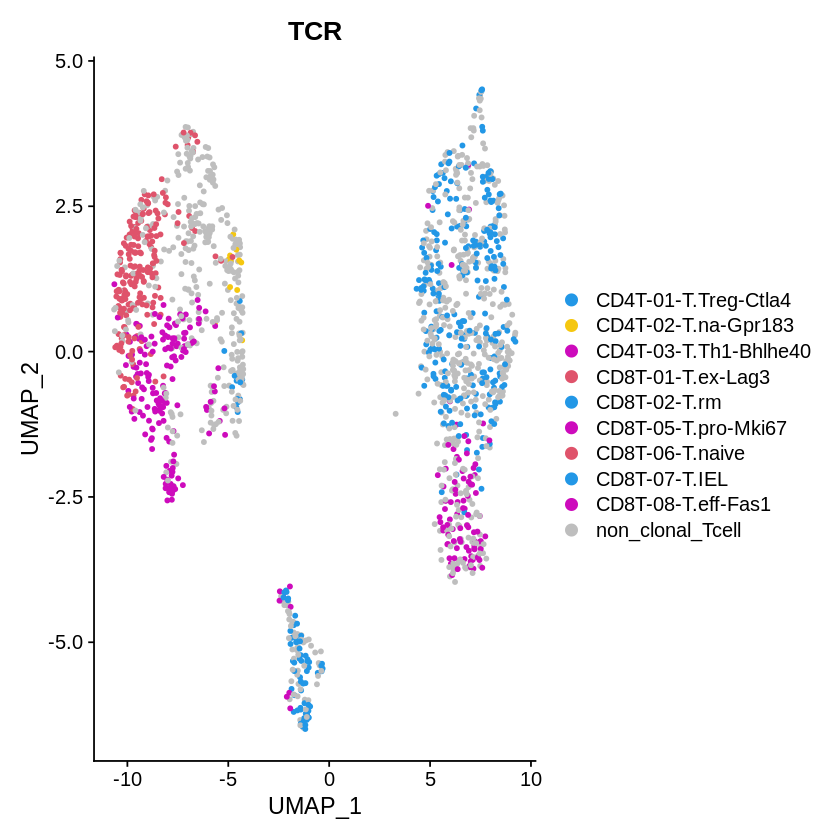

In [39]:
celllist1 <- rownames(t_cell_1@meta.data[t_cell_1@meta.data$TCR=="non_clonal_Tcell",])
celllist2 <- rownames(t_cell_1@meta.data[t_cell_1@meta.data$TCR %in% c("CD8T-01-T.ex-Lag3",
                                                 "CD8T-08-T.eff-Fas1","CD8T-02-T.rm",
                                                  "CD8T-05-T.pro-Mki67","CD4T-02-T.na-Gpr183",
                                                  "CD4T-01-T.Treg-Ctla4","CD4T-03-T.Th1-Bhlhe40",
                                                  "CD8T-06-T.naive","CD8T-07-T.IEL"),])
                                         
#p.conol1 <- DimPlot(t_cell_1,group.by="TCR",cells=celllist1,cols=c("non_clonal_Tcell"="azure3"))
#        DimPlot(t_cell_1,group.by="TCR",cells=celllist2 ,cols=c("CD8T-01-T.ex-Lag3"="#7FFFD4",
#                                                 "CD8T-08-T.eff-Fas1"="#458B74","CD8T-02-T.rm"="#FFE4C4",
#                                                  "CD8T-05-T.pro-Mki67"="#0000EE","CD4T-02-T.na-Gpr183"="#CD3333",
#                                                  "CD4T-01-T.Treg-Ctla4"="#EEC591","CD4T-03-T.Th1-Bhlhe40"="#7FFF00",
#                                                  "CD8T-06-T.naive"="cyan","CD8T-07-T.IEL"="darkred"),pt.size=0.1)
DimPlot(t_cell_1,group.by="TCR",cols=c("CD4T-01-T.Treg-Ctla4"=4,"CD4T-02-T.na-Gpr183"=79,"CD4T-03-T.Th1-Bhlhe40"=110,
                                       "CD8T-01-T.ex-Lag3"=130,"CD8T-02-T.rm"=140, "CD8T-05-T.pro-Mki67"=150, 
                                       "CD8T-06-T.naive"=170,"CD8T-07-T.IEL"=180,"CD8T-08-T.eff-Fas1"=190,
                                      "non_clonal_Tcell"="grey"),pt.size=1)

#DimPlot(t_cell_1,group.by="TCR",pt.size=1)
#ggsave(paste0(outpath,"/Tcells.annoted.pdf"), plot = p.annot, width = 10, height = 8)
#p.conol1

In [40]:
unique(t_cell_1@meta.data$orig.ident)

[1] "con" "vac"

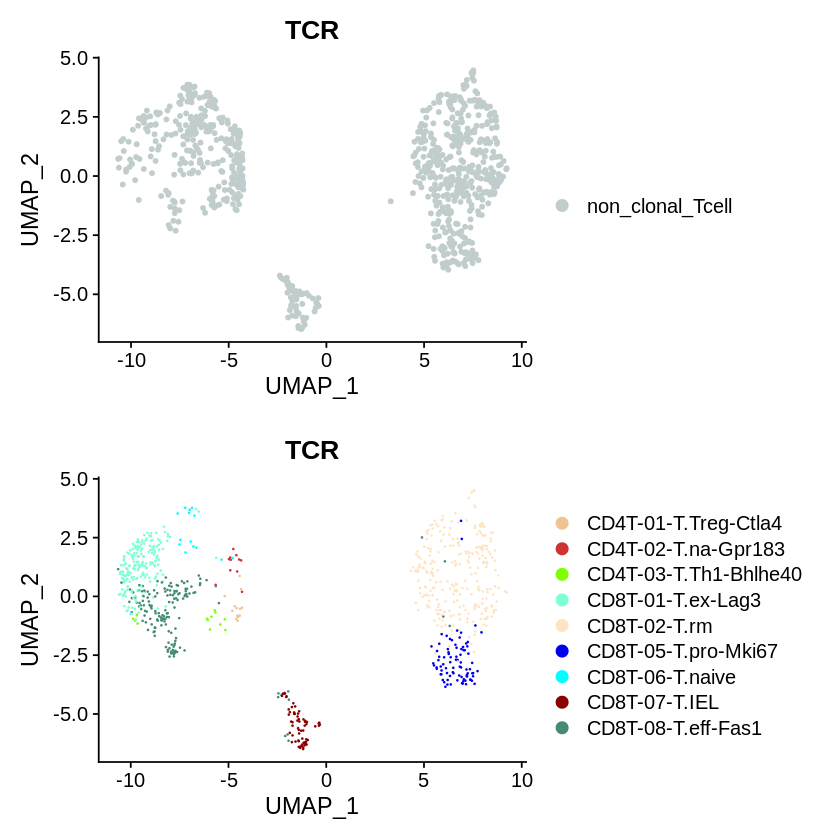

In [41]:
# 创建DimPlot对象  
p.conol1 <- DimPlot(t_cell_1, group.by="TCR", cells=celllist1, cols=c("non_clonal_Tcell"="azure3"))  
p.conol2 <- DimPlot(t_cell_1, group.by="TCR", cells=celllist2, cols=c("CD8T-01-T.ex-Lag3"="#7FFFD4",  
                                                                     "CD8T-08-T.eff-Fas1"="#458B74", "CD8T-02-T.rm"="#FFE4C4",  
                                                                     "CD8T-05-T.pro-Mki67"="#0000EE", "CD4T-02-T.na-Gpr183"="#CD3333",  
                                                                     "CD4T-01-T.Treg-Ctla4"="#EEC591", "CD4T-03-T.Th1-Bhlhe40"="#7FFF00",  
                                                                     "CD8T-06-T.naive"="cyan", "CD8T-07-T.IEL"="darkred"), pt.size=0.1)  
  
# 叠加图形  
library(cowplot)  
plot_grid(p.conol1, p.conol2, nrow = 2, align = "vh")

In [42]:
###get total clonal T
######################
umap_tag <- t_cell_1@reductions$umap@cell.embeddings %>% 
    as.data.frame() %>%
    cbind(tag = t_cell_1@meta.data$TCR)
umap_tag$size <- 0.5
umap_tag[umap_tag$tag == "non_clonal_Tcell",]$size <- 1
umap_tag$color <- "grey"
celltypelist <- unique(umap_tag$tag)
celltypelist <- celltypelist[celltypelist != "non_clonal_Tcell"]
colorlsit <- c("#7FFFD4","#458B74","#FFE4C4","#0000EE","#CD3333","#EEC591","#7FFF00","cyan","darkred")

print(length(celltypelist))
for (i in 1:length(celltypelist)){
    umap_tag[umap_tag$tag == celltypelist[i],]$color <- colorlsit[i]
    }

###get total clonal T in VAC
############################
umap_tag_vac <- t_cell_1@reductions$umap@cell.embeddings %>% 
    as.data.frame() %>%
    cbind(tag = t_cell_1@meta.data$TCR) %>%
    cbind(condition = t_cell_1@meta.data$orig.ident)
umap_tag_vac$size <- 0.5
umap_tag_vac[umap_tag_vac$tag == "non_clonal_Tcell",]$size <- 1
umap_tag_vac[umap_tag_vac$condition == "con",]$size <- 1

umap_tag_vac$color <- "grey"
celltypelist <- unique(umap_tag$tag)
celltypelist <- celltypelist[celltypelist != "non_clonal_Tcell"]
colorlsit <- c("#7FFFD4","#458B74","#FFE4C4","#0000EE","#CD3333","#EEC591","#7FFF00","cyan","darkred")
print(length(celltypelist))
for (i in 1:length(celltypelist)){
    umap_tag_vac[umap_tag_vac$tag == celltypelist[i],]$color <- colorlsit[i]
    }
umap_tag_vac[umap_tag_vac$condition == "con",]$color <- "grey"

###get total clonal T in CTRL
############################
umap_tag_ctrl <- t_cell_1@reductions$umap@cell.embeddings %>% 
    as.data.frame() %>%
    cbind(tag = t_cell_1@meta.data$TCR,condition = t_cell_1@meta.data$orig.ident)
umap_tag_ctrl$size <- 0.5
umap_tag_ctrl[umap_tag_ctrl$tag == "non_clonal_Tcell",]$size <- 1
umap_tag_ctrl[umap_tag_ctrl$condition == "vac",]$size <- 1

umap_tag_ctrl$color <- "grey"
celltypelist <- unique(umap_tag$tag)
celltypelist <- celltypelist[celltypelist != "non_clonal_Tcell"]
colorlsit <- c("#7FFFD4","#458B74","#FFE4C4","#0000EE","#CD3333","#EEC591","#7FFF00","cyan","darkred")

print(length(celltypelist))
for (i in 1:length(celltypelist)){
    umap_tag_ctrl[umap_tag_ctrl$tag == celltypelist[i],]$color <- colorlsit[i]
    }
umap_tag_ctrl[umap_tag_ctrl$condition == "vac",]$color <- "grey"


[1] 9
[1] 9
[1] 9


In [43]:
head(umap_tag_ctrl[umap_tag_ctrl$condition == "vac",],5)
head(umap_tag_vac[umap_tag_vac$condition == "con",],5)

,UMAP_1,UMAP_2,tag,condition,size,color
,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<chr>
AAACCTGCACCGGAAA-1_2,-6.409479,2.8598533,non_clonal_Tcell,vac,1,grey
AAAGATGGTCCTAGCG-1_2,-9.867757,1.1988545,CD8T-01-T.ex-Lag3,vac,1,grey
AAAGCAAGTCCGAGTC-1_2,8.591635,2.6841717,non_clonal_Tcell,vac,1,grey
AAAGCAATCTACCAGA-1_2,8.716995,-0.2188678,CD8T-02-T.rm,vac,1,grey
AACACGTAGTGGTAGC-1_2,5.051263,2.1391597,non_clonal_Tcell,vac,1,grey


,UMAP_1,UMAP_2,tag,condition,size,color
,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<chr>
AAACGGGAGATGAGAG-1_1,-9.882391,1.59590531,CD8T-01-T.ex-Lag3,con,1,grey
AAACGGGAGCCATCGC-1_1,-8.752931,0.76135970,CD8T-01-T.ex-Lag3,con,1,grey
AAACGGGAGGGCTTCC-1_1,-9.768911,-0.05186986,CD8T-08-T.eff-Fas1,con,1,grey
AAACGGGTCACCGTAA-1_1,5.503353,-0.78460574,non_clonal_Tcell,con,1,grey
AAAGATGAGCTAGGCA-1_1,-2.098796,-4.36303830,non_clonal_Tcell,con,1,grey


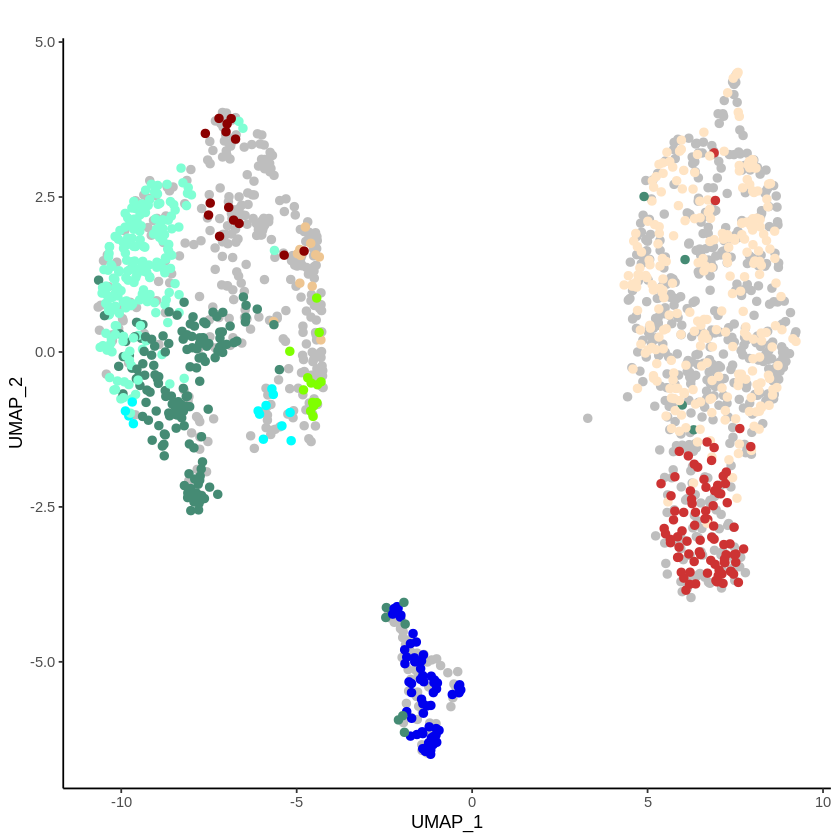

In [44]:
# 筛选行  
data_non_clonal <- filter(umap_tag, tag == "non_clonal_Tcell")  
data_other <- filter(umap_tag, tag != "non_clonal_Tcell")  

#df <- data.frame(x = numeric(0), y = numeric(0))  

# 创建散点图  
p <- ggplot(data = rbind(data_non_clonal,data_other), aes(x = UMAP_1, y = UMAP_2))+
  geom_point() +
  theme(panel.grid = element_blank()) + 
  theme_classic()+
  labs(title = "", x = "UMAP_1", y = "UMAP_2") +
  #scale_color_manual(values = c("non_clonal_Tcell" = "grey", "other" = data_other$color)) +
  geom_point(data = data_non_clonal, size = 2,color="grey") + # 设置non_clonal_Tcell的点大小为10  
  geom_point(data = data_other, size = 2,color=data_other$color) + # 设置其他细胞的点大小为5  
  theme(legend.position="right",legend.title=element_text())+
  scale_color_discrete(guide = guide_legend())
  #scale_fill_discrete(breaks=c("CD8T-01-T.ex-Lag3", "CD8T-08-T.eff-Fas1", "CD8T-02-T.rm",  
   #                              "CD8T-05-T.pro-Mki67", "CD4T-02-T.na-Gpr183"))
  
# 打印图形  
ggsave(paste0(outpath,"/Tcells.clonal.pdf"), plot = p, width = 10, height = 8)
print(p)

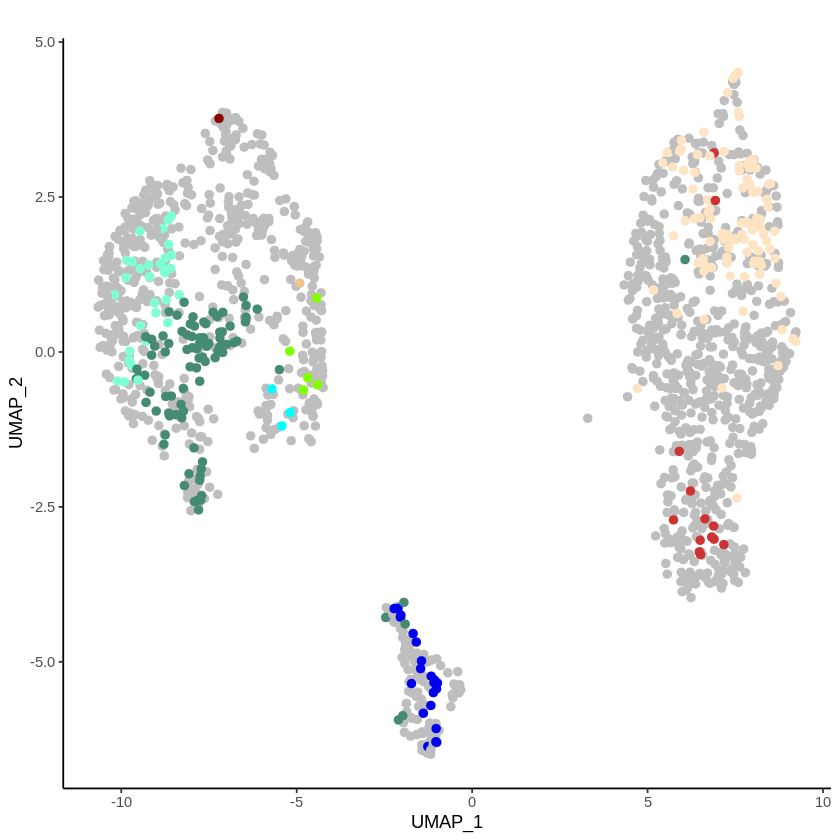

In [45]:
# 筛选行  
data_non_clonal <- filter(umap_tag_vac, tag == "non_clonal_Tcell")  
data_other <- filter(umap_tag_vac, tag != "non_clonal_Tcell")  

#df <- data.frame(x = numeric(0), y = numeric(0))  

# 创建散点图  
p <- ggplot(data = rbind(data_non_clonal,data_other), aes(x = UMAP_1, y = UMAP_2))+
  geom_point() +
  theme(panel.grid = element_blank()) + 
  theme_classic()+
  labs(title = "", x = "UMAP_1", y = "UMAP_2") +
  #scale_color_manual(values = c("non_clonal_Tcell" = "grey", "other" = data_other$color)) +
  geom_point(data = data_non_clonal, size = 2,color="grey") + # 设置non_clonal_Tcell的点大小为10  
  geom_point(data = data_other, size = 2,color=data_other$color) + # 设置其他细胞的点大小为5  
  theme(legend.position="right",legend.title=element_text())+
  scale_color_discrete(guide = guide_legend())
  #scale_fill_discrete(breaks=c("CD8T-01-T.ex-Lag3", "CD8T-08-T.eff-Fas1", "CD8T-02-T.rm",  
   #                              "CD8T-05-T.pro-Mki67", "CD4T-02-T.na-Gpr183"))
  
# 打印图形  
ggsave(paste0(outpath,"/Tcells.clonal.vac.pdf"), plot = p, width = 10, height = 8)
print(p)

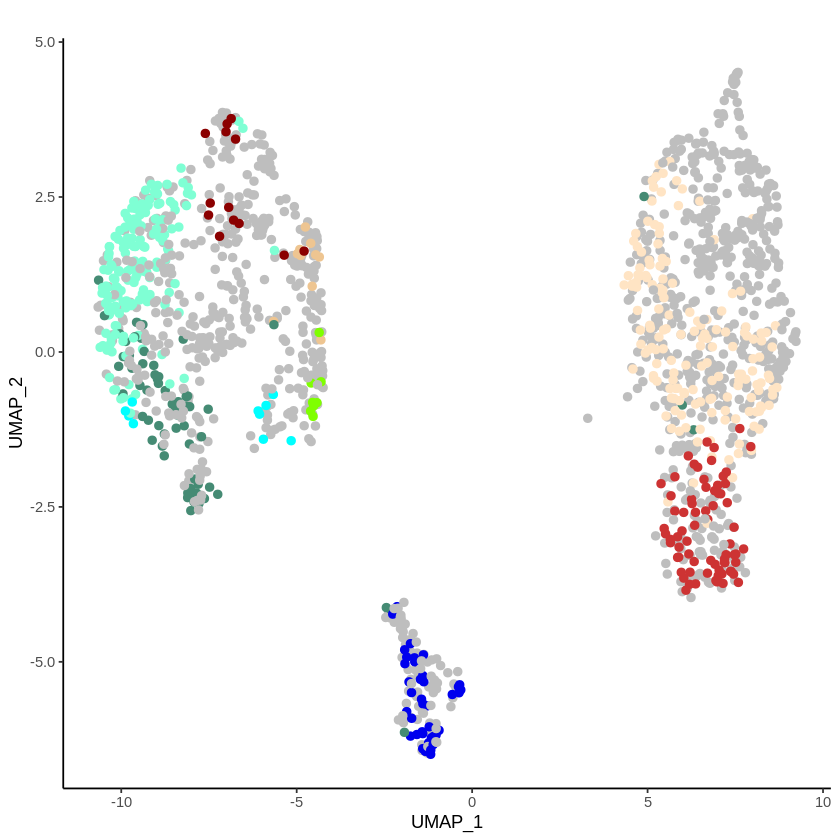

In [46]:
# 筛选行  
data_non_clonal <- filter(umap_tag_ctrl, tag == "non_clonal_Tcell")  
data_other <- filter(umap_tag_ctrl, tag != "non_clonal_Tcell")  

#df <- data.frame(x = numeric(0), y = numeric(0))  

# 创建散点图  
p <- ggplot(data = rbind(data_non_clonal,data_other), aes(x = UMAP_1, y = UMAP_2))+
  geom_point() +
  theme(panel.grid = element_blank()) + 
  theme_classic()+
  labs(title = "", x = "UMAP_1", y = "UMAP_2") +
  #scale_color_manual(values = c("non_clonal_Tcell" = "grey", "other" = data_other$color)) +
  geom_point(data = data_non_clonal, size = 2,color="grey") + # 设置non_clonal_Tcell的点大小为10  
  geom_point(data = data_other, size = 2,color=data_other$color) + # 设置其他细胞的点大小为5  
  theme(legend.position="right",legend.title=element_text())+
  scale_color_discrete(guide = guide_legend())
  #scale_fill_discrete(breaks=c("CD8T-01-T.ex-Lag3", "CD8T-08-T.eff-Fas1", "CD8T-02-T.rm",  
   #                              "CD8T-05-T.pro-Mki67", "CD4T-02-T.na-Gpr183"))
  
# 打印图形  
ggsave(paste0(outpath,"/Tcells.clonal.con.pdf"), plot = p, width = 10, height = 8)
print(p)

In [47]:
#Colonity Score
head(t_cell_1@meta.data,2)

,orig.ident,nCount_RNA,nFeature_RNA,treat,percent.mt,RNA_snn_res.0.08,RNA_snn_res.0.1,RNA_snn_res.0.5,seurat_clusters,RNA_snn_res.1.5,celltype_,TCR,ClonID,Freq,Exhuast
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<chr>,<chr>,<dbl>
AAACGGGAGATGAGAG-1_1,con,4252,1917,con.2,0.07055503,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype11,13,1.610367
AAACGGGAGCCATCGC-1_1,con,5038,1870,con.2,1.46883684,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype30,5,1.422734


In [48]:
###get total clonal T in VAC
############################
cell_id_CS <- t_cell_1@meta.data
treatlist <- c("con.2","vac.2")

celltypelistall <- unique(cell_id_CS$celltype_)

nrow <- length(treatlist)
ncol <- length(celltypelist)

df <- data.frame(matrix(nrow = nrow, ncol = ncol))  
rownames(df) <- c(treatlist)
colnames(df) <- c(celltypelist)
#print(df)
for (treat in treatlist) {
    print(treat)
    cell_id_CS_tr <- cell_id_CS[cell_id_CS$treat == treat,]
    celltypelist <- unique(cell_id_CS_tr$celltype_)
    for (celltype in celltypelist){
        #print(celltype)
        cell_id_CS_tr_ty <- cell_id_CS_tr[(cell_id_CS_tr$celltype_ == celltype) & (cell_id_CS_tr$ClonID != "_"),]
        clonotypes <- unique(cell_id_CS_tr_ty$ClonID)
        totalcell <- rownames(cell_id_CS_tr_ty)
        M <- length(totalcell)
        N <- length(clonotypes)
        #print(N)
        #print(M)
        suma <- 0
        freq <- 0
        for (clonoid in clonotypes){
            cell_id_CS_tr_ty_cl <- cell_id_CS_tr_ty[cell_id_CS_tr_ty$ClonID == clonoid,]
            Freq <- length(rownames(cell_id_CS_tr_ty_cl))/M
            freq <<- freq+Freq
            #print(Freq)
            #print(Freq*log2(Freq))
            suma <<- suma + Freq*log2(Freq)
        }
        CS <- 1 + (suma/log2(N))
        df[treat,celltype] <- CS    
    }
}

head(df)
write.csv(df,paste0(outpath,"/Tcells.ClonalScore.csv"))

[1] "con.2"
[1] "vac.2"


,CD8T-01-T.ex-Lag3,CD8T-08-T.eff-Fas1,CD8T-02-T.rm,CD8T-07-T.IEL,CD8T-05-T.pro-Mki67,CD4T-02-T.na-Gpr183,CD4T-01-T.Treg-Ctla4,CD4T-03-T.Th1-Bhlhe40,CD8T-06-T.naive
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
con.2,0.09743794,0.08512938,0.06531136,0.04216087,0.06949658,0.02500329,0.004848566,0.00971435,0.002717642
vac.2,0.03686035,0.08998828,0.06444760,0.03920368,0.01400650,0.00000000,0.017432407,0.01070274,0.000000000


In [49]:
# Create data
data <- data.frame(
  celltype=colnames(df) ,  
  colonal_score=c(0.08444653,0.06510098,0.004848566,0.02500329,0.09709430,0.0660629,0.004807806,0.00971435,0.04216087)
  )

# Barplot
p.con <-ggplot(data, aes(x=celltype, y=colonal_score)) + 
  geom_bar(stat = "identity", width=0.6,fill=c("#7FFFD4","#458B74","#FFE4C4","#0000EE","#CD3333","#EEC591","#7FFF00","cyan","#0000EE")) +
  theme(panel.background = element_blank())+
  theme(axis.text.x = element_text(angle = 45, hjust = 1))+
  theme(axis.text.y = element_text())


data <- data.frame(
  celltype=colnames(df) ,  
  colonal_score=c(0.08901983,0.06450535,0.017432407,0.00000000,0.03686035,0.0140065,0.000000000,0.01070274,0.03920368)
)

# Barplot
p.vac <-ggplot(data, aes(x=celltype, y=colonal_score)) + 
  geom_bar(stat = "identity", width=0.6,fill=c("#7FFFD4","#458B74","#FFE4C4","#0000EE","#CD3333","#EEC591","#7FFF00","cyan","#0000EE")) +
  theme(panel.background = element_blank())+
  theme(axis.text.x = element_text(angle = 45, hjust = 1))+
  theme(axis.text.y = element_text())

ggsave(paste0(outpath,"/Tcell.CS.con.pdf"), plot = p.con, width = 10, height = 8)
ggsave(paste0(outpath,"/Tcell.CS.vac.pdf"), plot = p.vac, width = 10, height = 8)

In [50]:
#ggsave(paste0(outpath,"/Tcells.clonal.con.pdf"), plot = p, width = 10, height = 8)

## Step4： T细胞亚群的 migration and state transition 分析

[1] "con.2"
[1] "vac.2"
                    CD8T-08-T.eff-Fas1 CD8T-02-T.rm CD8T-01-T.ex-Lag3
CD8T-08-T.eff-Fas1                  NA    0.5497630        0.52838428
CD8T-02-T.rm                 0.5891473           NA        0.37117904
CD8T-01-T.ex-Lag3            0.6705426    0.4502370                NA
CD8T-05-T.pro-Mki67          0.4534884    0.3791469        0.31441048
CD8T-06-T.naive              0.1085271    0.0521327        0.09170306
CD8T-07-T.IEL                0.5658915    0.4597156        0.43231441
                    CD8T-05-T.pro-Mki67 CD8T-06-T.naive CD8T-07-T.IEL
CD8T-08-T.eff-Fas1           0.54285714      0.13636364    0.58119658
CD8T-02-T.rm                 0.51428571      0.11363636    0.52136752
CD8T-01-T.ex-Lag3            0.52857143      0.15909091    0.58119658
CD8T-05-T.pro-Mki67                  NA      0.06818182    0.40170940
CD8T-06-T.naive              0.08571429              NA    0.07692308
CD8T-07-T.IEL                0.48571429      0.09090909           

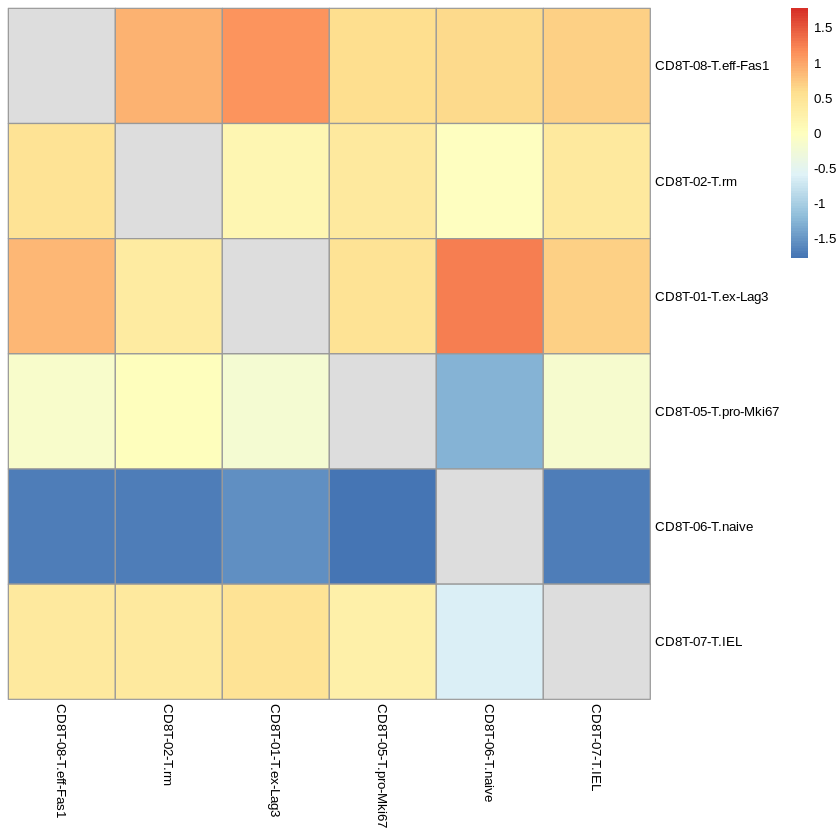

In [51]:

############################
###  CD8T cells         ####
############################
cell_id_mig_cd8 <- t_cell_1@meta.data[t_cell_1@meta.data$celltype_  %like% "CD8T",]
treatlist <- c("con.2","vac.2")


#print(df)
for (treat in treatlist) {
    print(treat)
    
    cell_id_mig_cd8_tr <- cell_id_mig_cd8[(cell_id_mig_cd8$treat == treat) & (cell_id_mig_cd8$ClonID != "_"),]
    celltypelist <- unique(cell_id_mig_cd8_tr$celltype_)

    nrow <- length(celltypelist)
    ncol <- length(celltypelist)
    df <- data.frame(matrix(0,nrow = nrow, ncol = ncol)) 
    rownames(df) <- c(celltypelist)
    colnames(df) <- c(celltypelist)


    
    for (celltype in celltypelist){

        cell_id_mig_cd8_tr_ty <- cell_id_mig_cd8_tr[cell_id_mig_cd8_tr$celltype_ == celltype ,]
        
        clonotypelist <- unique(cell_id_mig_cd8_tr_ty$ClonID)
        cellnum <- rownames(cell_id_mig_cd8_tr_ty)
        
        for (clonoid in clonotypelist){
            #print(clonoid)
            cell_id_mig_cd8_tr_cl <- cell_id_mig_cd8_tr[cell_id_mig_cd8_tr$ClonID == clonoid,]

            for (celltype2 in celltypelist){
                cellnum <- length(rownames(cell_id_mig_cd8_tr_cl[cell_id_mig_cd8_tr_cl$celltype_ == celltype2,]))
                df[celltype,celltype2] <- df[celltype,celltype2] + cellnum
            }
        }

    if (treat == "con.2") {
        df.con.2 <- df}
    else
        if (treat =="vac.2") {
            df.vac.2 <- df}
    }
}

    df_all <- df.vac.2+df.con.2
    df_all <- apply(df_all,2,function(x) x/max(x))
    df_all[df_all=="1"] <- NA
    p.migr <- pheatmap(df_all, cluster_row = FALSE, cluster_col = FALSE, na_color = "white", fontsize = 8, scale = "column", labels_row = rownames(df_all))
    print(df_all)
    ggsave(paste0(outpath,"/Tcell.migration.pdf"), plot = p.migr, width = 8, height = 8)

In [52]:
df.vac.2+df.con.2

,CD8T-08-T.eff-Fas1,CD8T-02-T.rm,CD8T-01-T.ex-Lag3,CD8T-05-T.pro-Mki67,CD8T-06-T.naive,CD8T-07-T.IEL
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CD8T-08-T.eff-Fas1,258,116,121,38,6,68
CD8T-02-T.rm,152,211,85,36,5,61
CD8T-01-T.ex-Lag3,173,95,229,37,7,68
CD8T-05-T.pro-Mki67,117,80,72,70,3,47
CD8T-06-T.naive,28,11,21,6,44,9
CD8T-07-T.IEL,146,97,99,34,4,117


In [53]:
head(cell_id_mig_cd8,2)
dim(t_cell_1@meta.data)
dim(t_cell_1@meta.data[(t_cell_1@meta.data$Freq  == "_"),])
dim(t_cell_1@meta.data[(t_cell_1@meta.data$Freq  != "_"),])
dim(t_cell_1@meta.data[(t_cell_1@meta.data$Freq  != "_") & (t_cell_1@meta.data$celltype_  %like% "CD8T"),])
dim(t_cell_1@meta.data[(t_cell_1@meta.data$Freq  != "_") & (t_cell_1@meta.data$celltype_  %like% "CD4T"),])

,orig.ident,nCount_RNA,nFeature_RNA,treat,percent.mt,RNA_snn_res.0.08,RNA_snn_res.0.1,RNA_snn_res.0.5,seurat_clusters,RNA_snn_res.1.5,celltype_,TCR,ClonID,Freq,Exhuast
,<chr>,<dbl>,<int>,<chr>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<chr>,<chr>,<dbl>
AAACGGGAGATGAGAG-1_1,con,4252,1917,con.2,0.07055503,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype11,13,1.610367
AAACGGGAGCCATCGC-1_1,con,5038,1870,con.2,1.46883684,2,2,9,0,0,CD8T-01-T.ex-Lag3,CD8T-01-T.ex-Lag3,clonotype30,5,1.422734


[1] 1647   15

[1] 386  15

[1] 1261   15

[1] 1147   15

[1] 114  15

In [54]:
t_cell_1_subset <-  subset(t_cell_1,idents = c("CD8T-01-T.ex-Lag3","CD8T-07-T.IEL","CD8T-08-T.eff-Fas1"))
dim(t_cell_1_subset)

[1] 16092   570

In [55]:
write_rds(t_cell_1_subset@meta.data,"/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/06.trajectories/tcell_subset.metadata.rds","xz")

In [56]:
write_rds(t_cell_1_subset@assays$RNA@counts,"/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/06.trajectories/tcell_subset.expression_matrix.rds","xz")

## Step5：T细胞亚群的轨迹（Trajectories）分析

In [57]:
library(monocle3)
library(ggplot2)

Loading required package: Biobase

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'browseVignettes()'. To cite Bioconductor, see
    'citation("Biobase")', and for packages 'citation("pkgname")'.


Loading required package: SingleCellExperiment



In [58]:
outpath <- "/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38"

In [59]:
expression_matrix_2 <- readRDS(paste0(outpath,"/06.trajectories/tcell_subset.expression_matrix.rds"))
cell_metadata_2 <- readRDS(paste0(outpath,"/06.trajectories/tcell_subset.metadata.rds"))

cds_2 <- new_cell_data_set(expression_matrix_2,
                         cell_metadata = cell_metadata_2)

Warning message in new_cell_data_set(expression_matrix_2, cell_metadata = cell_metadata_2):
“Warning: gene_metadata must contain a column verbatim named 'gene_short_name' for certain functions.”


No preprocess_method specified, and aligned coordinates have been computed previously. Using preprocess_method = 'Aligned'

No trajectory to plot. Has learn_graph() been called yet?



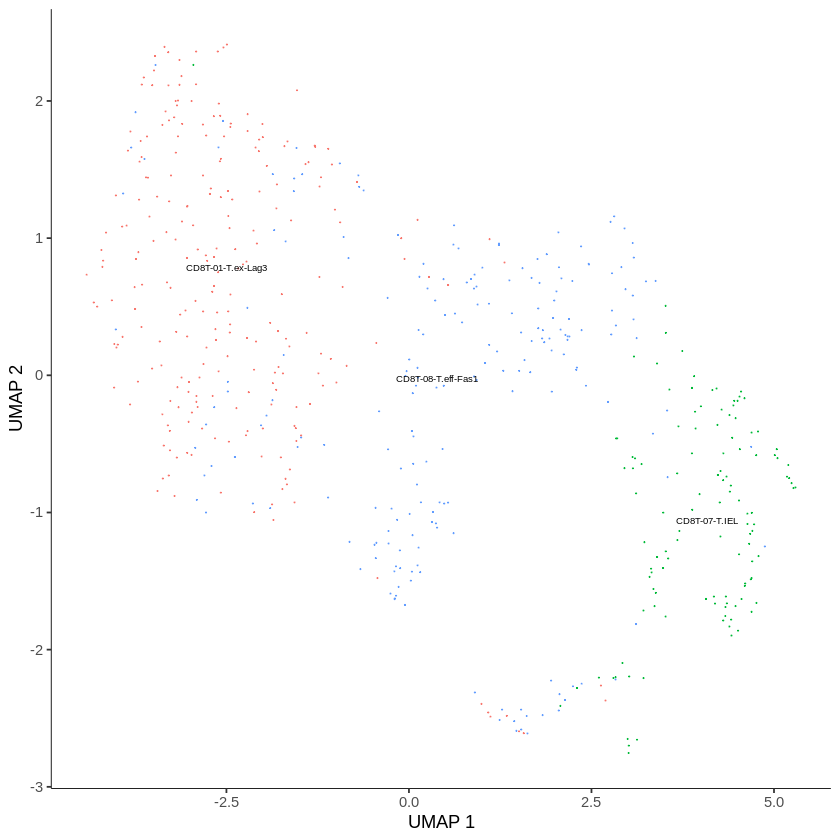

In [60]:
cds_2 <- preprocess_cds(cds_2, num_dim = 50, useNames = TRUE)
cds_2 <- align_cds(cds_2)
cds_2 <- reduce_dimension(cds_2,reduction_method="UMAP")
plot_cells(cds_2, label_groups_by_cluster=FALSE, color_cells_by = "celltype_")

No trajectory to plot. Has learn_graph() been called yet?



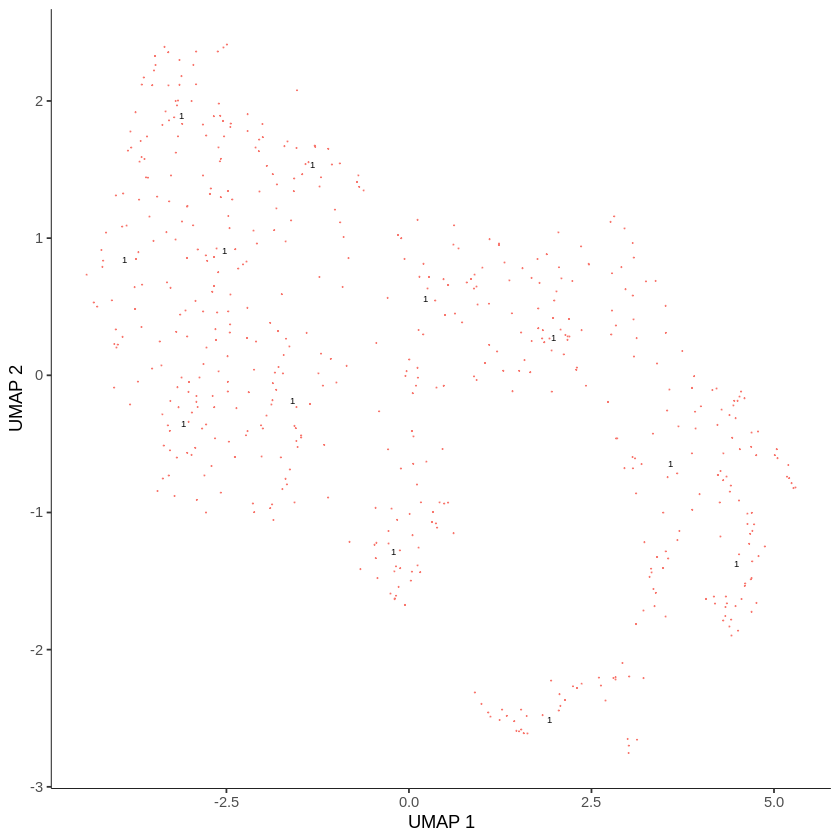

In [61]:
cds_2 <- cluster_cells(cds_2,cluster_method = 'louvain')
cds_2 <- cluster_cells(cds_2,cluster_method = 'louvain')
#subset_cds <- subset(cds_2, partition = c(1,1))
plot_cells(cds_2, color_cells_by = "partition")

Warning message in igraph::graph.dfs(stree_ori, root = root_cell, neimode = "all", :
“Argument `neimode' is deprecated; use `mode' instead”
Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.
ℹ The deprecated feature was likely used in the monocle3 package.
  Please report the issue to the authors.”


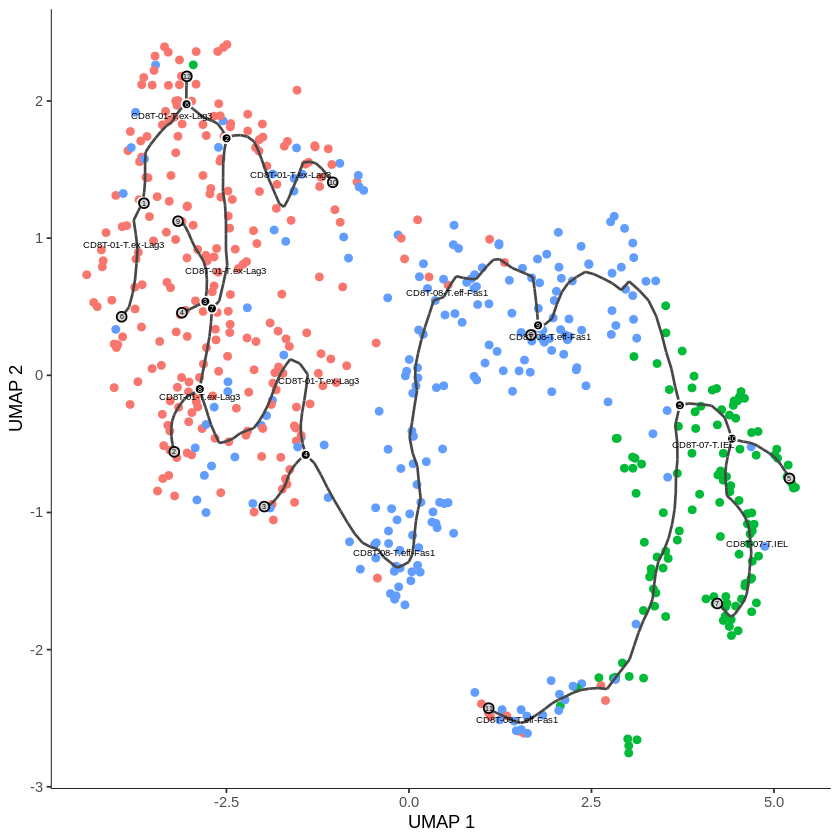

In [63]:
cds_2 <- learn_graph(cds_2)
plot_cells(cds_2,
           color_cells_by = "celltype_",
           label_groups_by_cluster=TRUE,
           label_leaves=TRUE,
           label_branch_points=TRUE,
           graph_label_size=1.5,
           cell_size = 1.5)

[1] 2


Cells aren't colored in a way that allows them to be grouped.



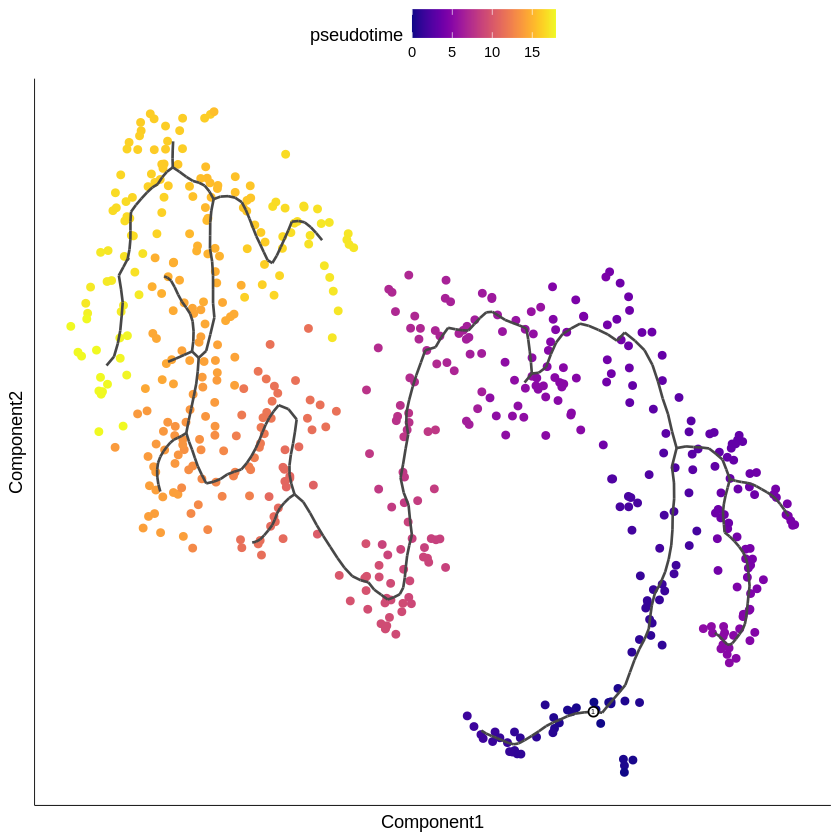

In [79]:
for (i in 2){
    print(i)
cds_2_sub_pseu <- order_cells(cds_2,root_pr_nodes=paste0("Y_",i))
p <- plot_cells(cds_2_sub_pseu,
           color_cells_by = "pseudotime",
           label_cell_groups=TRUE,
           label_leaves=FALSE,
           label_branch_points=FALSE,
           graph_label_size=1.5,
           cell_size = 1.5)+
    xlab("Component1") + ylab("Component2")+
    theme(
        axis.text.x = element_blank(),
        axis.text.y = element_blank(),
        axis.ticks.x = element_blank(),
        axis.ticks.y = element_blank(),
        legend.position = "top",
        legend.direction = "horizontal",
        legend.margin = margin(0, 0, 0, 0)
        )+
    guides(fill = guide_legend(override.aes = list(label = NULL))) 
    print(p)
    ggsave(paste0(outpath,"/Tcell.migration.pseudotime2.pdf"), plot = p, width = 6, height = 6)
}

In [80]:
df1 <- data.frame(cds_2_sub_pseu@principal_graph_aux@listData$UMAP$pseudotime)
nrow(df1)
df2 <- data.frame(cds_2_sub_pseu@colData@listData$Exhuast)
nrow(df2)

[1] 570

[1] 570

In [81]:
df1["Exhaust"] <-df2
# 根据 pseudotime 排序数据
df1_sorted <- df1[order(df1$cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime),]
head(df1_sorted)

,cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime,Exhaust
,<dbl>,<dbl>
CTGGTCTAGAGAGCTC-1_3,0.00000000,1.4580817
CTCTAATTCAACCATG-1_3,0.02968857,-0.7616933
TCGCGAGTCCGTAGTA-1_1,0.06498021,1.2790024
ACACCAACAAACCTAC-1_1,0.07853616,1.7665856
AAAGCAATCAGAGACG-1_1,0.26471885,-0.7616933
TTGACTTGTGAAGGCT-1_1,0.27590494,0.9135260


In [ ]:
# 过滤掉 Exhaust 值为 -0.7616933 的数据
dim(df1_sorted)
filtered_df <- df1_sorted[df1_sorted$Exhaust > -0.7516933, ]

library(viridis)
#library(ggpmisc)

# Set breakpoints for color scale
breaks <- c(min(filtered_df$cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime), 
            median(filtered_df$cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime), 
            max(filtered_df$cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime))

# Create the plot with custom color gradient
p <- ggplot(filtered_df, aes(x = cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime, 
                             y = Exhaust, 
                             color = cds_2_sub_pseu.principal_graph_aux.listData.UMAP.pseudotime)) +
  geom_point(size = 3, alpha = 0.7) +
  #geom_line(data = trend_data, aes(x = x, y = y), color = "blue") +
  geom_smooth(method = "lm", se = TRUE, color = "black", formula = y ~ poly(x, 2)) +
  stat_smooth(method = "lm", se = TRUE, formula = y ~ poly(x, 2),
              method.args = list(formula = y ~ poly(x, 2), se = TRUE),  ) +
  scale_color_gradient(low = "#20068F", high = "#F0F822", breaks = breaks, 
                       labels = c("#20068F", "#B32C8E", "#F0F822")) +
  theme_void()+
  labs(title = "Exhaust vs Pseudotime Distribution",
       x = "Pseudotime",
       y = "Exhaust score",
       color = "Pseudotime")  # Set legend title
ggsave(paste0("/home/jovyan/work/02.ResDev/17.Singlecell/02.NJU_MC38/06.trajectories/Tcell.pseu_vs_Exhuastscore.pdf"), plot = p, width = 8, height = 8)